In [3]:
# gpu
# import cudf
# import cuml
# import rmm
# from cuml.manifold import TSNE

# cpu
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from clustergram import Clustergram
from minisom import MiniSom
import numpy as np

In [5]:
rmm.reinitialize(managed_memory=True)
assert(rmm.is_initialized())

In [4]:
df = pd.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/convolutions.pq")

In [5]:
df = df.fillna(0)

In [6]:
data = (df-df.mean())/df.std()

In [6]:
data

,stcOri_q1,stcOri_q2,stcOri_q3,stbOri_q1,stbOri_q2,stbOri_q3,stbCeA_q1,stbCeA_q2,stbCeA_q3,sdcLAL_q1,...,lseCWA_q3,lteOri_q1,lteOri_q2,lteOri_q3,lteWNB_q1,lteWNB_q2,lteWNB_q3,lieWCe_q1,lieWCe_q2,lieWCe_q3
tID,,,,,,,,,,,,,,,,,,,,,
0,-0.765428,-1.036946,-1.343368,-0.836283,-1.024255,-1.210914,-0.493246,-0.596989,-0.777423,-0.009435,...,-0.163423,-0.969958,-1.019912,-1.068334,0.329578,0.420000,0.574130,-0.014026,-0.016042,-0.016061
1,-0.743337,-1.034457,-1.337423,-0.823824,-1.017163,-1.216582,-0.505864,-0.631576,-0.807774,0.186441,...,-0.183731,-0.971369,-1.022765,-1.080539,0.329578,0.247841,0.090214,-0.013388,-0.016042,-0.022057
2,-0.746032,-1.034457,-1.337423,-0.824800,-1.017163,-1.216582,-0.505864,-0.631576,-0.811288,0.159770,...,-0.183731,-0.971369,-1.022765,-1.080539,0.329578,0.247841,0.090214,-0.013388,-0.016042,-0.022057
3,-0.753247,-1.045080,-1.343132,-0.839045,-1.033370,-1.225088,-0.501205,-0.628518,-0.801293,0.159770,...,-0.183731,-0.971369,-1.022765,-1.080539,0.329578,0.247841,0.090214,-0.013388,-0.016042,-0.022057
4,-0.753247,-1.045080,-1.350720,-0.839045,-1.033370,-1.205088,-0.472674,-0.597849,-0.755351,0.161811,...,-0.183731,-0.971369,-1.022765,-1.080539,0.329578,0.247841,0.090214,-0.013388,-0.016042,-0.022057
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82370,-0.080546,-0.341971,-0.544045,-0.136110,-0.311982,-0.481744,4.411588,2.273688,0.909619,1.916955,...,-0.123379,-0.333129,-0.327966,-0.323115,-1.411289,-0.715113,-0.232835,-0.029497,-0.027106,-0.024998
82371,-0.526298,-0.342414,-0.543970,-0.172995,-0.311982,-0.461528,-0.057302,1.029714,1.737786,3.000662,...,1.469756,-0.283873,-0.246806,-0.073326,-1.601286,-1.039988,-0.349235,-0.029497,-0.031561,-0.027073
82372,-0.201472,-0.300567,-0.515339,-0.127655,-0.303204,-0.467431,-0.173855,0.136119,-0.140248,4.603946,...,3.062891,-0.259277,-0.063852,0.112767,-1.791282,-1.483300,-0.739487,-0.029497,-0.031802,-0.029369


In [4]:
labels = pd.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/cluster_labels.pq")
labels

,tID,clusters,f_clusters,ss_clusters
0,0,0,7,0
1,1,0,7,0
2,2,0,7,0
3,3,0,7,0
4,4,0,6,0
...,...,...,...,...
82370,82370,9,7,12
82371,82371,12,7,3
82372,82372,12,7,3
82373,82373,12,6,3


In [21]:
tsne = TSNE(n_components = 2, method = 'barnes_hut', random_state=23, perplexity=50, n_neighbors=150, learning_rate=5)
%time embedding = tsne.fit_transform(data.fillna(0))

[W] [18:56:48.873065] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...
CPU times: user 2.34 s, sys: 2.72 s, total: 5.06 s
Wall time: 5.04 s


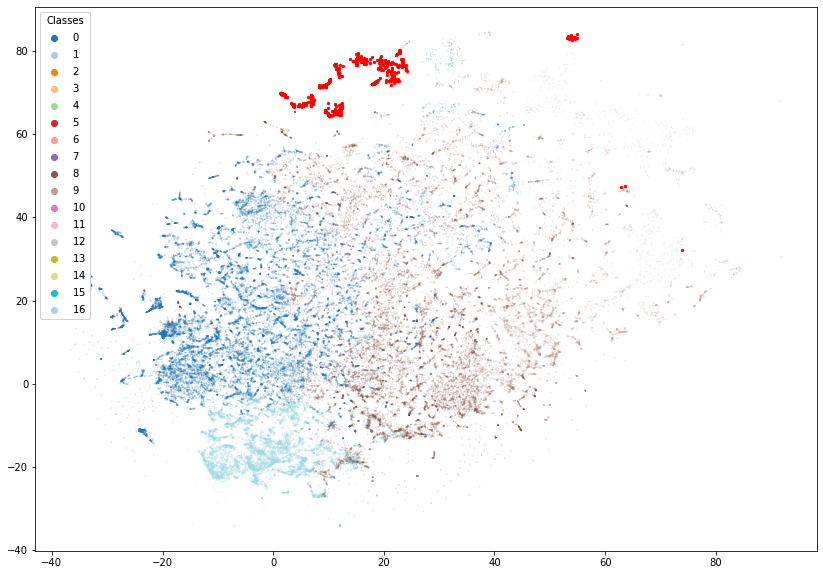

In [22]:
fig, ax = plt.subplots(1, figsize = (14, 10))
scatter = plt.scatter(embedding[0].to_array(), embedding[1].to_array(), s = 0.01, c=labels.clusters.values, cmap='tab20', label=labels.clusters.values)
scatter2 = plt.scatter(embedding[0].to_array()[~labels.clusters.isin([0, 16, 8, 9, 12])], embedding[1].to_array()[~labels.clusters.isin([0, 16, 8, 9, 12])], s = 5, c='r')
legend1 = ax.legend(*scatter.legend_elements('colors', 18),
                    loc="upper left", title="Classes")
ax.add_artist(legend1)

In [10]:
pca_float = cuml.PCA(n_components = 2)
pca_float.fit(data.T.fillna(0))

MemoryError: std::bad_alloc: CUDA error at: ../include/rmm/mr/device/managed_memory_resource.hpp:72: cudaErrorMemoryAllocation out of memory

In [23]:
pca_float = PCA(n_components = 2)
pca_float.fit(data.T.fillna(0).to_pandas())

PCA(n_components=2)

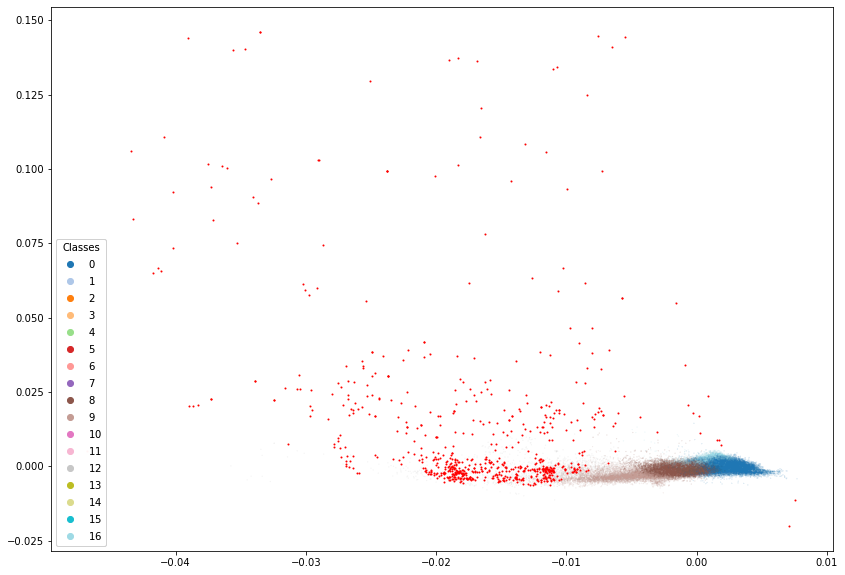

In [24]:
fig, ax = plt.subplots(1, figsize = (14, 10))
scatter = plt.scatter(pca_float.components_[0], pca_float.components_[1], s = .005, c=labels.clusters.values, cmap='tab20', label=labels.clusters.values)
scatter2 = plt.scatter(pca_float.components_[0][~labels.clusters.isin([0, 16, 8, 9, 12])], pca_float.components_[1][~labels.clusters.isin([0, 16, 8, 9, 12])], s = 1, c='r')
legend1 = ax.legend(*scatter.legend_elements('colors', 18),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)

In [41]:
dbscan = cuml.DBSCAN(eps=25, min_samples=1000)
dbscan.fit(data)

DBSCAN(eps=25, handle=<cuml.raft.common.handle.Handle object at 0x7fb95594cdb0>, min_samples=1000, verbose=4, max_mbytes_per_batch=0, output_type='cudf', calc_core_sample_indices=True)

In [42]:
dbscan.labels_.value_counts()

 0    81521
-1      854
dtype: int32

In [15]:
gdf = gpd.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/func_data.pq", columns=['tessellation', 'buildings'])

<AxesSubplot:>

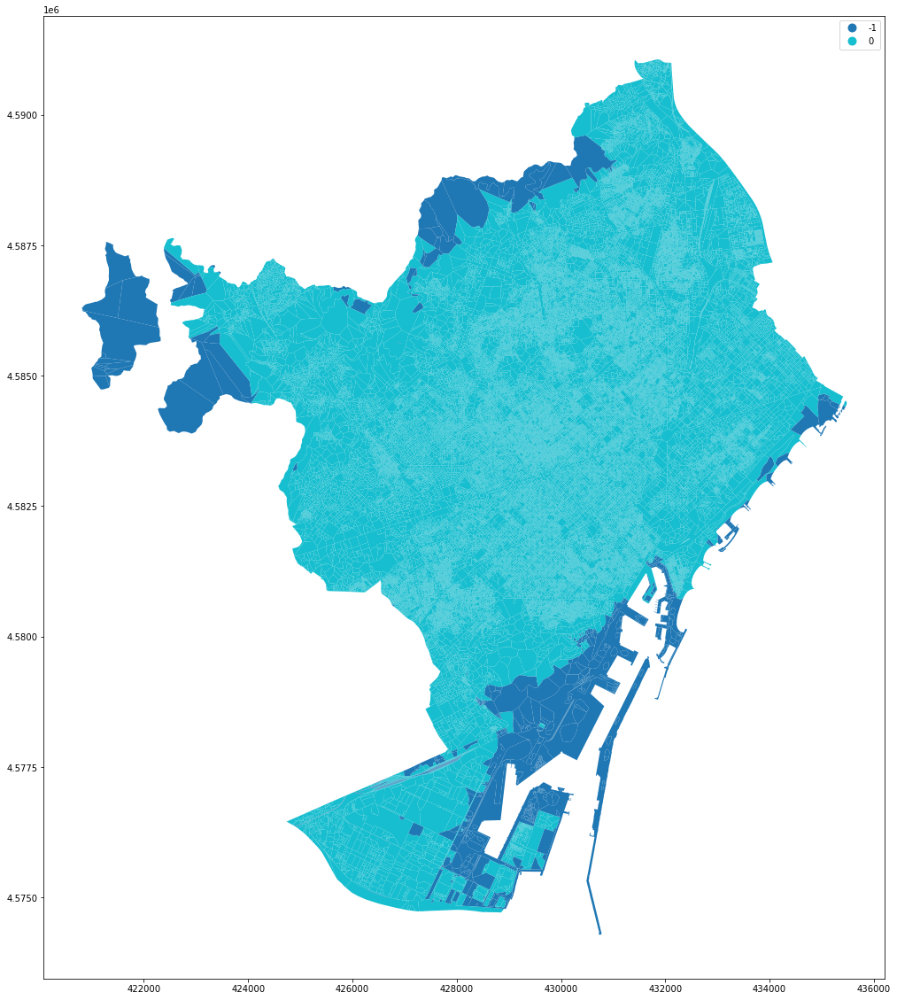

In [43]:
gdf.plot(dbscan.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)

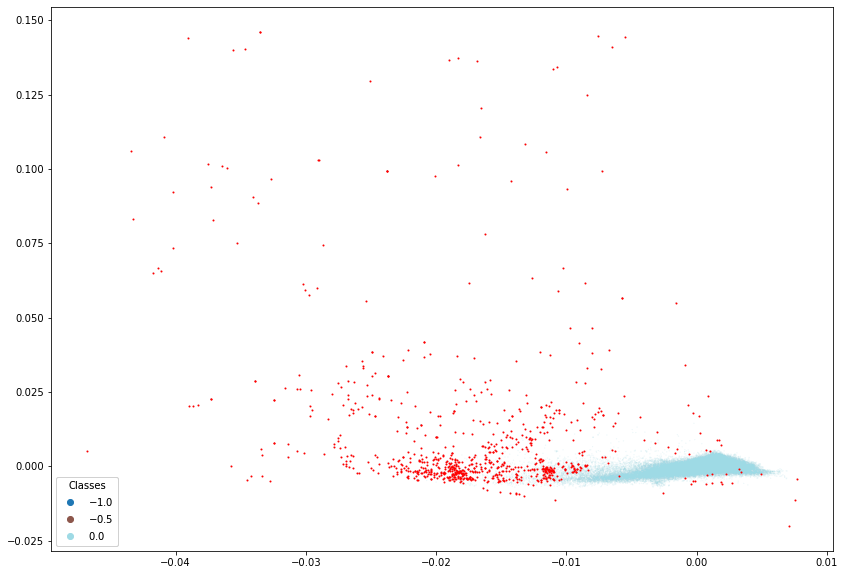

In [47]:
fig, ax = plt.subplots(1, figsize = (14, 10))

labs = dbscan.labels_.to_array()

scatter = plt.scatter(pca_float.components_[0], pca_float.components_[1], s = .005, c=labs, cmap='tab20')
scatter2 = plt.scatter(pca_float.components_[0][labs != 0], pca_float.components_[1][labs != 0], s = 1, c='r', cmap='tab20')
# scatter2 = plt.scatter(pca_float.components_[0][~labels.clusters.isin([0, 16, 8, 9, 12])], pca_float.components_[1][~labels.clusters.isin([0, 16, 8, 9, 12])], s = 1, c='r')
legend1 = ax.legend(*scatter.legend_elements('colors', 2),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)

In [48]:
cg = Clustergram(range(1, 30), backend='cuML', n_init=10)
cg.fit(data[labs == 0].fillna(0))

PCA computed in 0.5150232315063477 seconds.
K=1 fitted in 1.4002814292907715 seconds.
K=2 fitted in 4.117992162704468 seconds.
K=3 fitted in 3.798488140106201 seconds.
K=4 fitted in 5.766303539276123 seconds.
K=5 fitted in 4.623988151550293 seconds.
K=6 fitted in 6.067348003387451 seconds.
K=7 fitted in 6.945812702178955 seconds.
K=8 fitted in 7.403814792633057 seconds.
K=9 fitted in 9.181161165237427 seconds.
K=10 fitted in 8.755526304244995 seconds.
K=11 fitted in 12.167209148406982 seconds.
K=12 fitted in 11.175405025482178 seconds.
K=13 fitted in 14.51637887954712 seconds.
K=14 fitted in 15.342625617980957 seconds.
K=15 fitted in 16.198330640792847 seconds.
K=16 fitted in 17.859007358551025 seconds.
K=17 fitted in 19.468127727508545 seconds.
K=18 fitted in 18.572174549102783 seconds.
K=19 fitted in 22.0594539642334 seconds.
K=20 fitted in 22.702703952789307 seconds.
K=21 fitted in 20.25305438041687 seconds.
K=22 fitted in 22.773881196975708 seconds.
K=23 fitted in 23.79771971702575

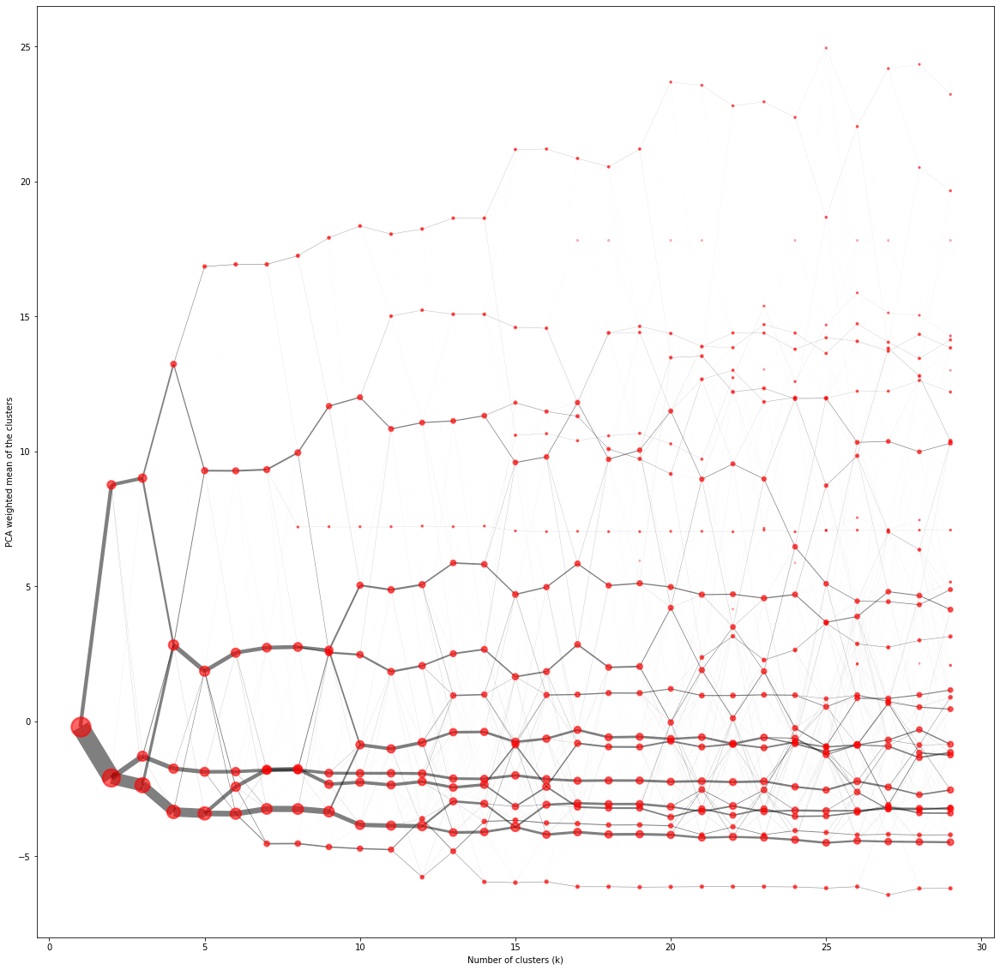

In [49]:
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})

PCA computed in 0.10293245315551758 seconds.
K=1 fitted in 1.4625706672668457 seconds.
K=2 fitted in 1.4933133125305176 seconds.
K=3 fitted in 1.8198699951171875 seconds.
K=4 fitted in 2.6966264247894287 seconds.
K=5 fitted in 3.4267964363098145 seconds.
K=6 fitted in 4.156064033508301 seconds.
K=7 fitted in 4.619518995285034 seconds.
K=8 fitted in 4.292588472366333 seconds.
K=9 fitted in 4.293422698974609 seconds.
K=10 fitted in 4.592234373092651 seconds.
K=11 fitted in 5.211864709854126 seconds.
K=12 fitted in 5.895902633666992 seconds.
K=13 fitted in 5.854001045227051 seconds.
K=14 fitted in 8.50324273109436 seconds.
K=15 fitted in 10.350634574890137 seconds.
K=16 fitted in 9.947759628295898 seconds.
K=17 fitted in 10.612266778945923 seconds.
K=18 fitted in 8.372377634048462 seconds.
K=19 fitted in 9.967509746551514 seconds.
K=20 fitted in 10.014095067977905 seconds.
K=21 fitted in 10.79461407661438 seconds.
K=22 fitted in 13.145453691482544 seconds.
K=23 fitted in 10.77751803398132

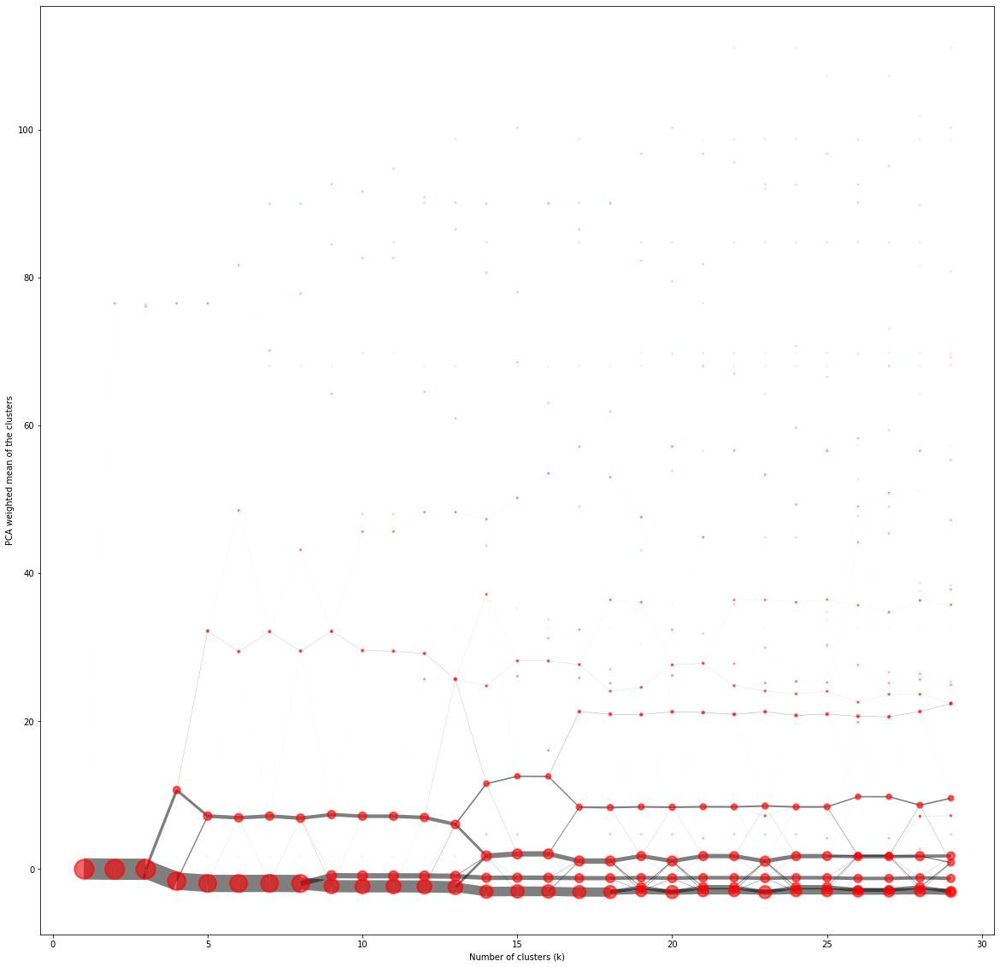

In [50]:
cg = Clustergram(range(1, 30), backend='cuML', n_init=10)
cg.fit(data)
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})

In [51]:
km = cuml.KMeans(n_clusters=6, n_init=100).fit(data[labs == 0])

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

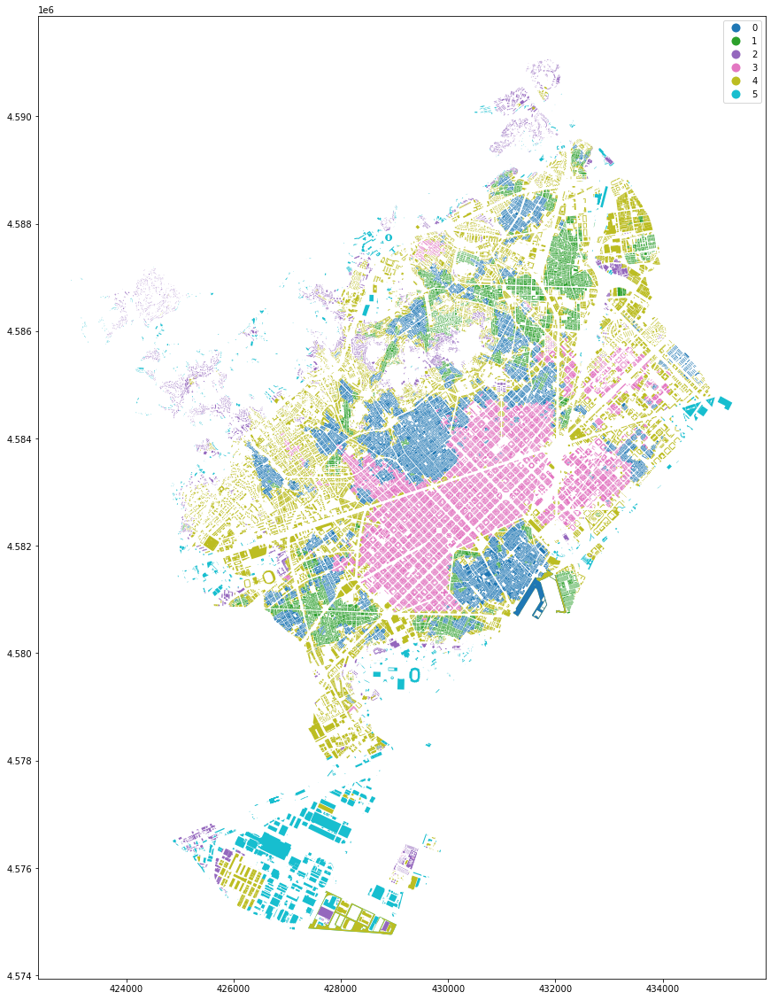

In [52]:
gdf[labs == 0].set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].set_geometry('buildings').plot(color='k', ax=ax)

<AxesSubplot:>

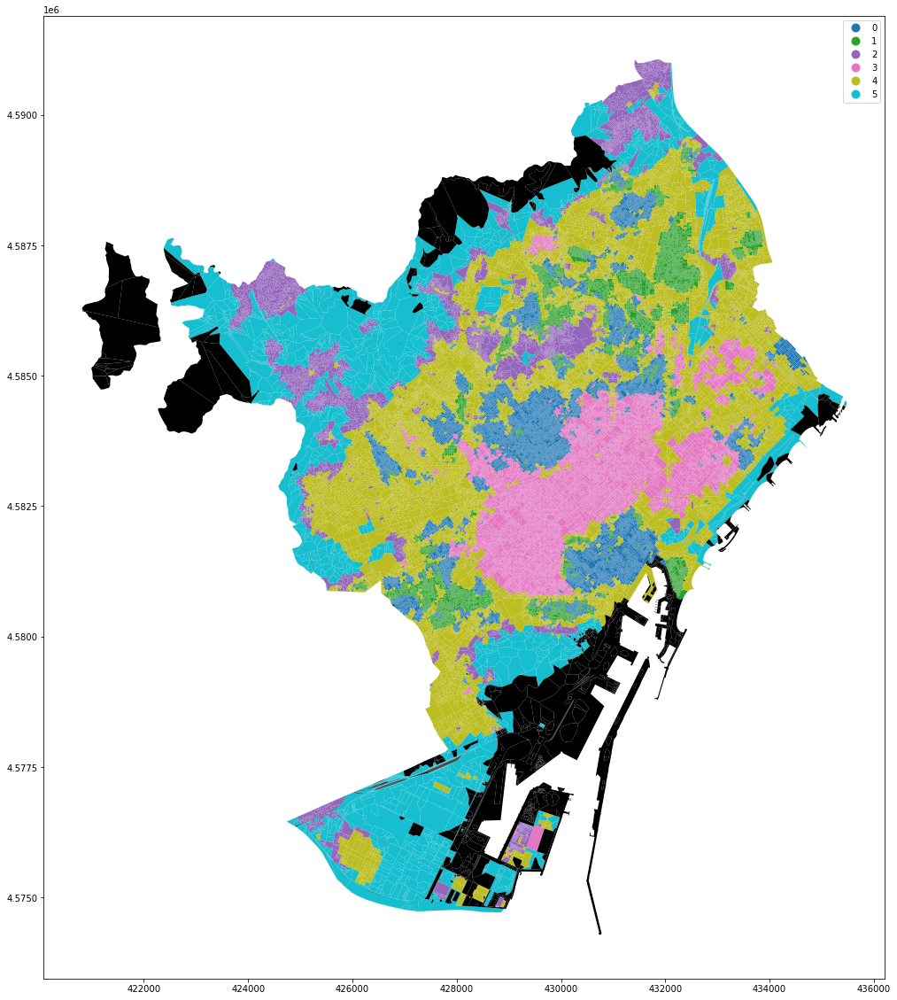

In [53]:
ax = gdf[labs == 0].plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].plot(color='k', ax=ax)

In [71]:
km = cuml.KMeans(n_clusters=10, n_init=50).fit(data[labs == 0])

<AxesSubplot:>

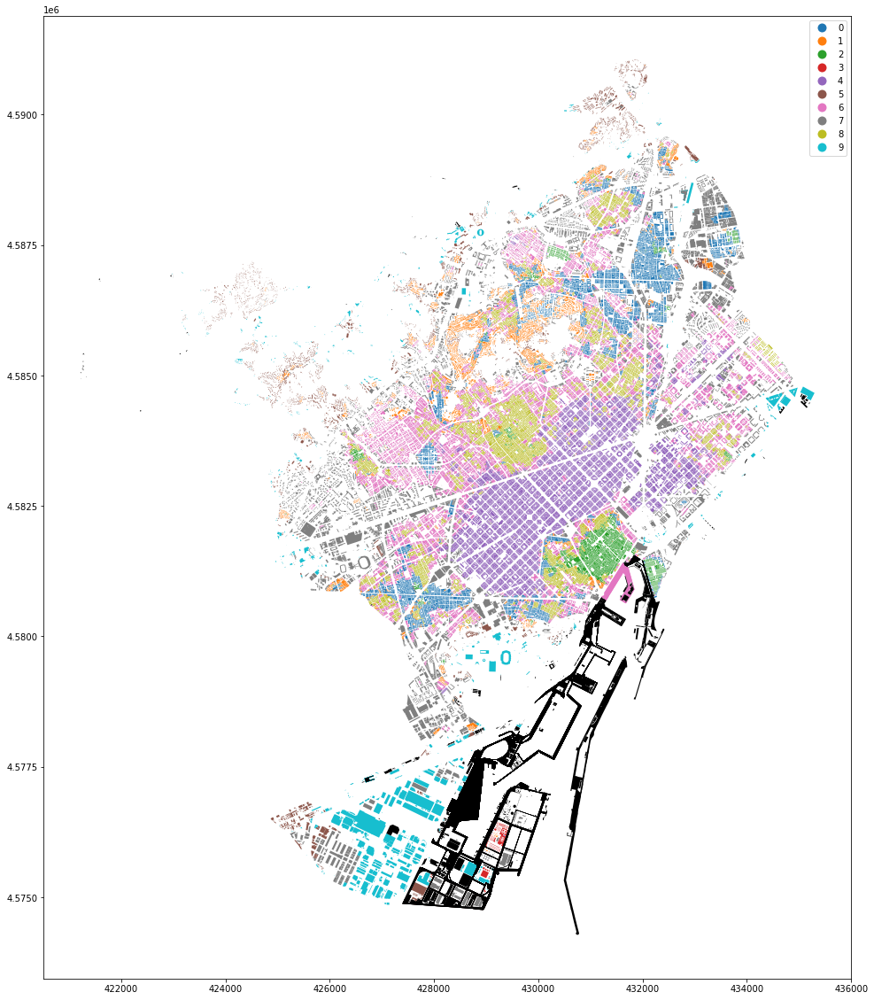

In [72]:
ax = gdf[labs == 0].set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].set_geometry('buildings').plot(color='k', ax=ax)

<AxesSubplot:>

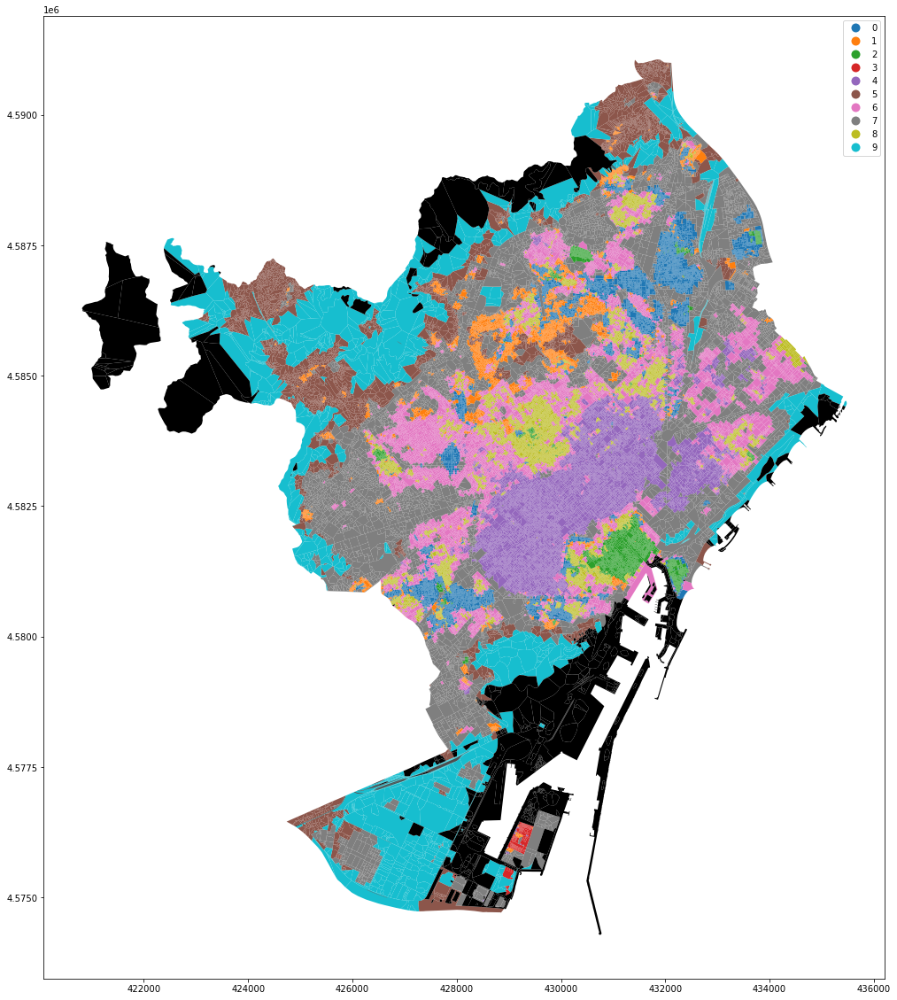

In [56]:
ax = gdf[labs == 0].plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].plot(color='k', ax=ax)

In [30]:
npdata = data.fillna(0).values

In [32]:
npdata.max()

276.94620816626656

In [119]:
som_shape = (3, 4)

In [125]:
som = MiniSom(som_shape[0], som_shape[1], npdata.shape[1], sigma=.01, learning_rate=.01,
              neighborhood_function='gaussian', random_seed=10)

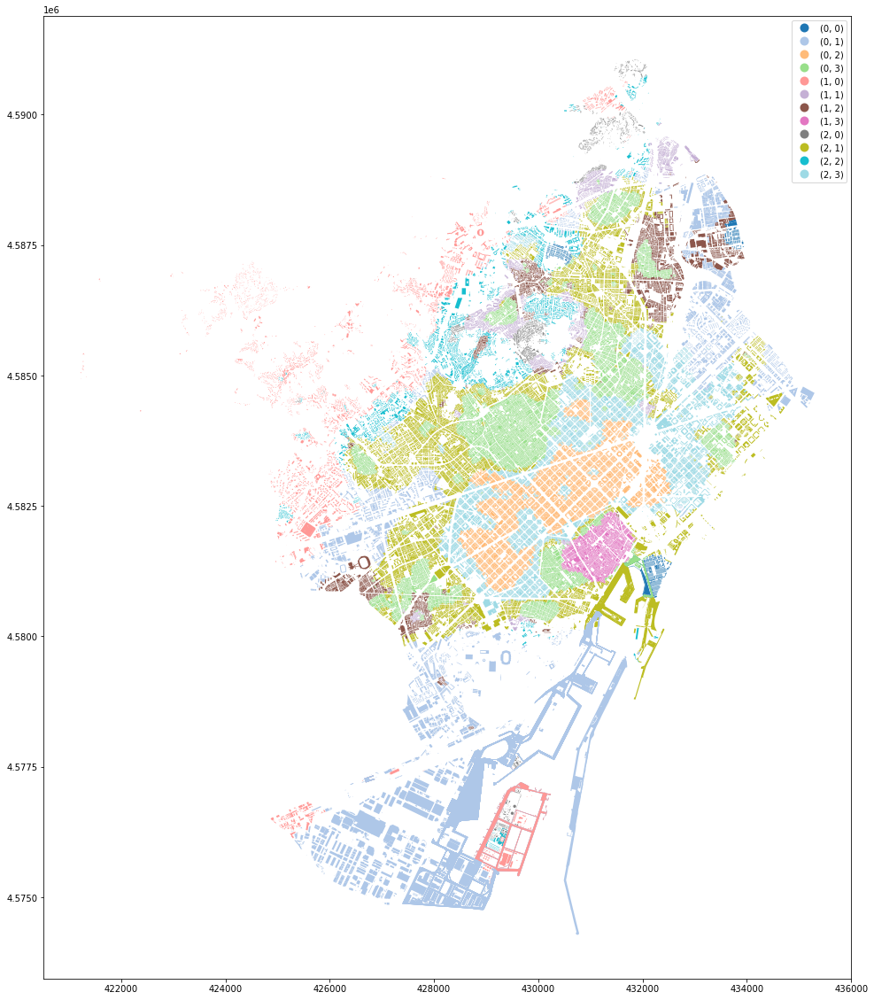

In [129]:
som.train_batch(npdata, 50000, verbose=True)

winner_coordinates = np.array([som.winner(x) for x in npdata])
hashes = np.apply_along_axis(lambda x: str(tuple(x)), 1, winner_coordinates)
ax = gdf.set_geometry('buildings').plot(hashes, legend=True, figsize=(20, 20), categorical=True, cmap='tab20')

In [27]:
som_shape = (4, 4)
som = MiniSom(som_shape[0], som_shape[1], npdata.shape[1], sigma=.5, learning_rate=.25,
              neighborhood_function='gaussian', random_seed=10)
som.train_batch(npdata, 50000, verbose=True)

 [ 50000 / 50000 ] 100% - 0:00:00 left 
 quantization error: nan


In [66]:
winner_coordinates = np.array([som.winner(x) for x in npdata])
hashes = np.apply_along_axis(lambda x: str(tuple(x)), 1, winner_coordinates)

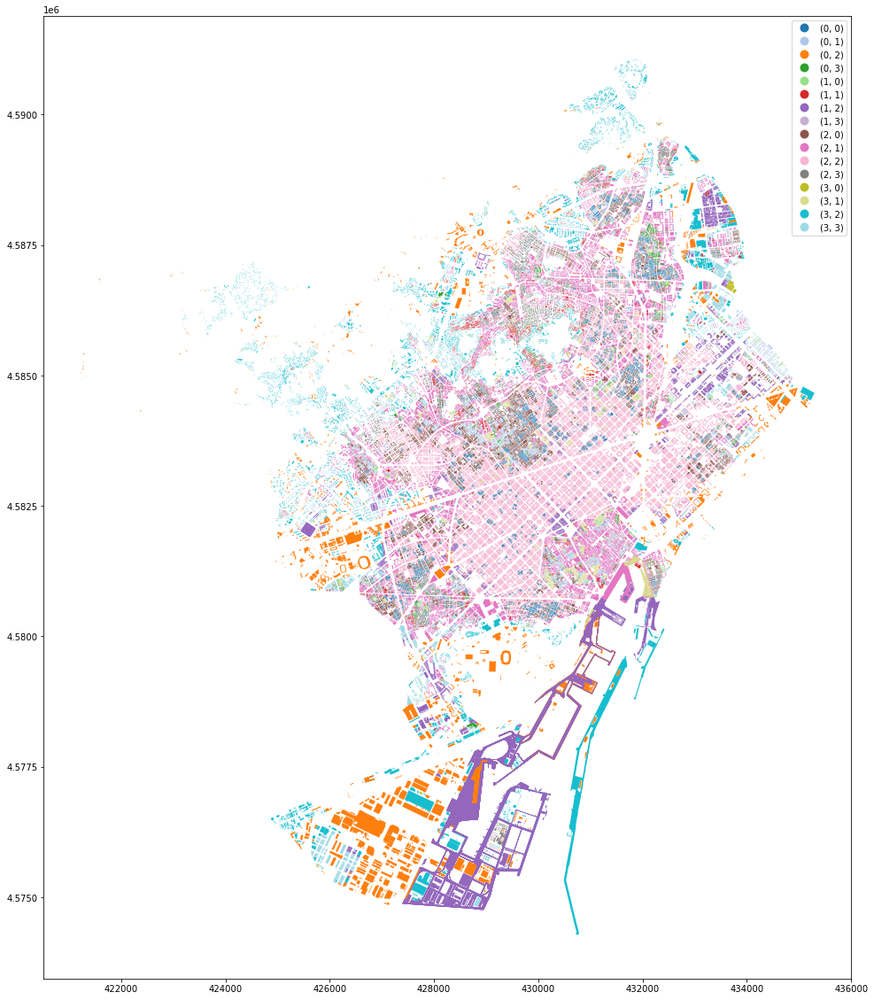

In [67]:
ax = gdf.set_geometry('buildings').plot(hashes, legend=True, figsize=(20, 20), categorical=True, cmap='tab20')

In [68]:
som_shape = (3, 3)
som = MiniSom(som_shape[0], som_shape[1], npdata.shape[1], sigma=.5, learning_rate=.25,
              neighborhood_function='gaussian', random_seed=10)
som.train_batch(npdata[labs == 0], 50000, verbose=True)

 [ 50000 / 50000 ] 100% - 0:00:00 left 
 quantization error: 9.492632806029764


In [69]:
winner_coordinates = np.array([som.winner(x) for x in npdata[labs == 0]])
hashes = np.apply_along_axis(lambda x: str(tuple(x)), 1, winner_coordinates)

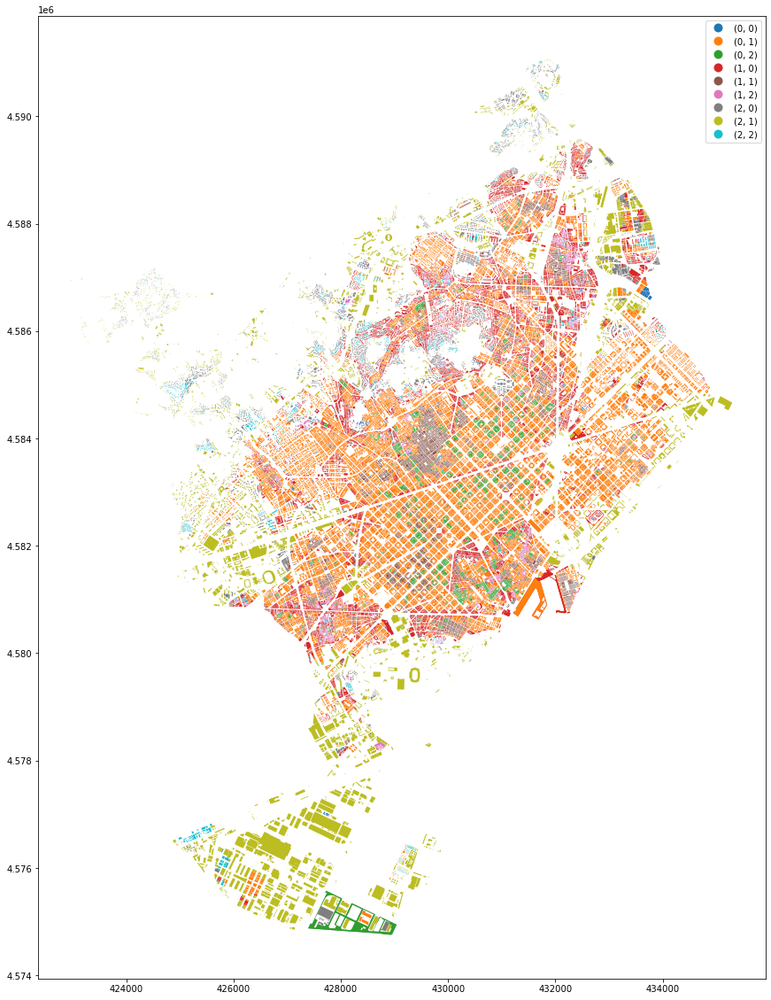

In [70]:
ax = gdf[labs == 0].set_geometry('buildings').plot(hashes, legend=True, figsize=(20, 20), categorical=True)

In [88]:
from sklearn.mixture import GaussianMixture

In [76]:
n = 10

gmm = GaussianMixture(n_components=n, covariance_type="full", max_iter=200, n_init=5, verbose=1)
fitted = gmm.fit(data[labs == 0].as_matrix())

Initialization 0
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
  Iteration 70
Initialization converged: True
Initialization 1
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
  Iteration 70
  Iteration 80
  Iteration 90
  Iteration 100
  Iteration 110
  Iteration 120
Initialization converged: True
Initialization 2
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
Initialization converged: True
Initialization 3
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
Initialization converged: True
Initialization 4
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
  Iteration 70
  Iteration 80
  Iteration 90
Initialization converged: True


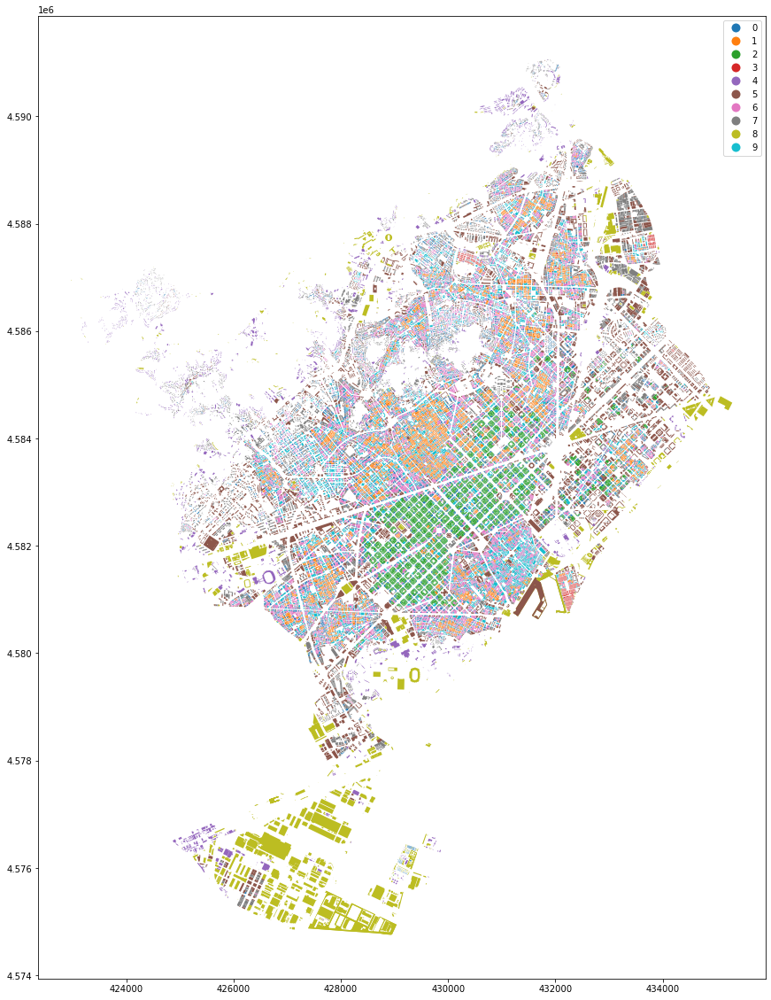

In [78]:
ax = gdf[labs == 0].set_geometry('buildings').plot(gmm.predict(data[labs == 0].as_matrix()), legend=True, figsize=(20, 20), categorical=True)

## Convolutions based on larger number of neighbours

In [79]:
prim = gpd.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/data.pq")

In [80]:
prim.geometry.name

'tessellation'

In [85]:
from momepy import sw_high
from libpysal.weights import Queen

In [87]:
%time queen = Queen.from_dataframe(prim, geom_col='tessellation')
%time queen_10 = sw_high(k=10, weights=queen)

CPU times: user 2min 9s, sys: 4.62 s, total: 2min 13s
Wall time: 2min 13s


In [88]:
characters = ['stcOri', 'stbOri',
       'stbCeA', 'sdcLAL', 'sdcAre', 'sscCCo', 'sscERI', 'sicCAR', 'mtbAli',
       'mtbNDi', 'mtcWNe', 'mdcAre', 'ltbIBD',
       'stcSAl', 'ltcWRE',
       'sdbAre', 'sdbPer', 'sdbCoA', 'ssbCCo', 'ssbCor', 'ssbSqu',
       'ssbERI', 'ssbElo', 'ssbCCM', 'ssbCCD', 'mtbSWR', 'ldbPWL', 'stbSAl',
       'libNCo', 'sdsLen', 'sdsSPW', 'sdsSPO', 'sdsSWD', 'sssLin', 'sdsAre',
       'sisBpM', 'misRea', 'mdsAre', 'ldsMSL', 'degree', 'meshedness',
       'proportion_3', 'proportion_4', 'proportion_0', 'local_closeness',
       'ldsCDL', 'xcnSCl', 'mtdMDi', 'lddNDe', 'linWID', 'sddAre', 'ldeAre',
       'ldePer', 'lseCCo', 'lseERI', 'lseCWA', 'lteOri', 'lteWNB', 'lieWCe']
data = prim.set_index('tID')[characters]

In [90]:
from tqdm import tqdm
import pandas as pd
import numpy as np

convolutions = {}
for c in characters:
    convolutions[c] = []

# measure convolutions
for i in tqdm(data.index, total=data.shape[0]):
    neighbours = [i]
    neighbours += queen_10.neighbors[i]

    vicinity = data.iloc[neighbours]
    for c in characters:
        convolutions[c].append(np.nanpercentile(vicinity[c], [25, 50, 75], interpolation='midpoint'))

100%|██████████| 82375/82375 [11:43<00:00, 117.12it/s]


In [91]:
%time conv = pd.DataFrame(convolutions, index=data.index)
%time exploded = pd.concat([pd.DataFrame(conv[c].to_list(), columns=[c + '_q1', c + '_q2',c + '_q3']) for c in characters], axis=1)
exploded.index = data.index
exploded.to_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/convolutions_q10.pq")

CPU times: user 1.03 s, sys: 28.8 ms, total: 1.06 s
Wall time: 1.05 s
CPU times: user 6.82 s, sys: 45.8 ms, total: 6.87 s
Wall time: 6.86 s


In [92]:
%time queen_3 = sw_high(k=3, weights=queen)
convolutions = {}
for c in characters:
    convolutions[c] = []

# measure convolutions
for i in tqdm(data.index, total=data.shape[0]):
    neighbours = [i]
    neighbours += queen_3.neighbors[i]

    vicinity = data.iloc[neighbours]
    for c in characters:
        convolutions[c].append(np.nanpercentile(vicinity[c], [25, 50, 75], interpolation='midpoint'))
conv = pd.DataFrame(convolutions, index=data.index)
exploded_3 = pd.concat([pd.DataFrame(conv[c].to_list(), columns=[c + '_q1', c + '_q2',c + '_q3']) for c in characters], axis=1)
exploded_3.index = data.index
exploded_3.to_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/convolutions_q3.pq")

  0%|          | 14/82375 [00:00<10:20, 132.69it/s]

CPU times: user 5.51 s, sys: 103 ms, total: 5.61 s
Wall time: 5.6 s


 95%|█████████▍| 77921/82375 [09:36<00:33, 134.71it/s]/opt/conda/envs/rapids/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1368: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(
100%|██████████| 82375/82375 [10:10<00:00, 135.03it/s]


In [18]:
df3 = cudf.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/convolutions_q3.pq")
df3 = df3.fillna(0)
data = (df3 - df3.mean()) / df3.std()

PCA computed in 0.9020164012908936 seconds.
K=1 fitted in 1.4722132682800293 seconds.
K=2 fitted in 2.3437063694000244 seconds.
K=3 fitted in 3.4525182247161865 seconds.
K=4 fitted in 4.602993011474609 seconds.
K=5 fitted in 3.89237380027771 seconds.
K=6 fitted in 4.350352764129639 seconds.
K=7 fitted in 4.025259733200073 seconds.
K=8 fitted in 4.879567861557007 seconds.
K=9 fitted in 7.693552732467651 seconds.
K=10 fitted in 7.329221248626709 seconds.
K=11 fitted in 7.839165449142456 seconds.
K=12 fitted in 7.893970489501953 seconds.
K=13 fitted in 8.288496255874634 seconds.
K=14 fitted in 9.418133735656738 seconds.
K=15 fitted in 8.428847074508667 seconds.
K=16 fitted in 8.08144235610962 seconds.
K=17 fitted in 9.912070989608765 seconds.
K=18 fitted in 12.976916074752808 seconds.
K=19 fitted in 16.065617561340332 seconds.
K=20 fitted in 12.817716598510742 seconds.
K=21 fitted in 15.094518184661865 seconds.
K=22 fitted in 15.057557344436646 seconds.
K=23 fitted in 12.943334817886353 s

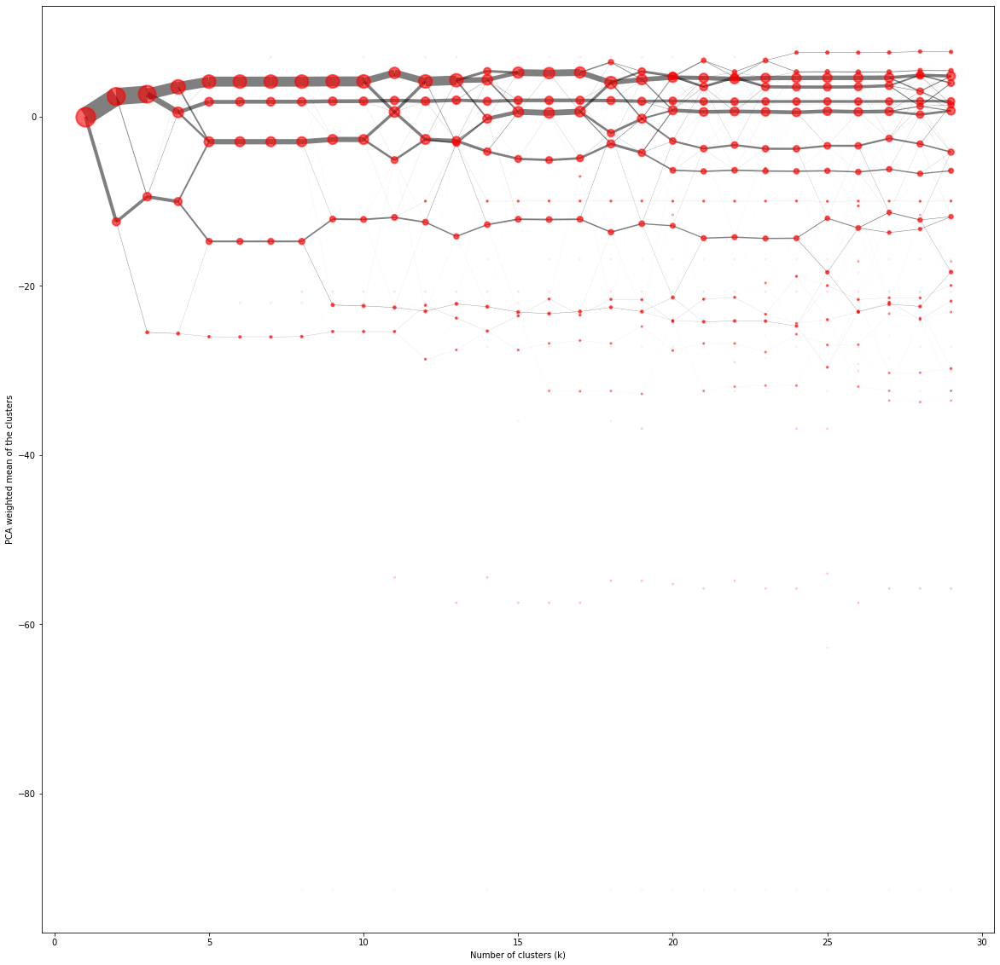

In [7]:
cg = Clustergram(range(1, 30), backend='cuML', n_init=10)
cg.fit(data)
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})

In [8]:
tsne = TSNE(n_components = 2, method = 'barnes_hut', random_state=23, perplexity=50, n_neighbors=150, learning_rate=5)
%time embedding = tsne.fit_transform(data)

[W] [20:51:07.322343] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...
CPU times: user 1.63 s, sys: 2.14 s, total: 3.77 s
Wall time: 3.75 s


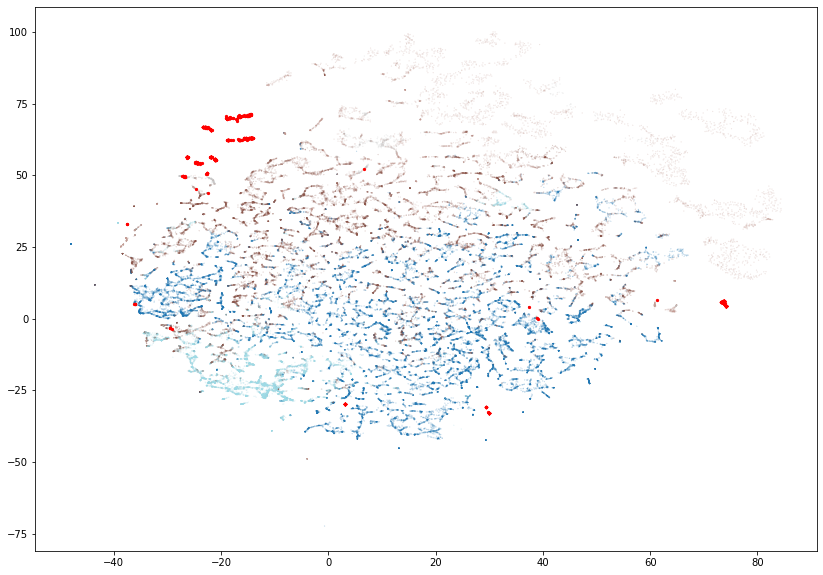

In [10]:
fig, ax = plt.subplots(1, figsize = (14, 10))
scatter = plt.scatter(embedding[0].to_array(), embedding[1].to_array(), s = 0.01, c=labels.clusters.values, cmap='tab20', label=labels.clusters.values)
scatter2 = plt.scatter(embedding[0].to_array()[~labels.clusters.isin([0, 16, 8, 9, 12])], embedding[1].to_array()[~labels.clusters.isin([0, 16, 8, 9, 12])], s = 5, c='r')
# legend1 = ax.legend(*scatter.legend_elements('colors', 18),
#                     loc="upper left", title="Classes")
# ax.add_artist(legend1)

In [12]:
pca_float = PCA(n_components = 2)
pca_float.fit(data.T.to_pandas())

PCA(n_components=2)

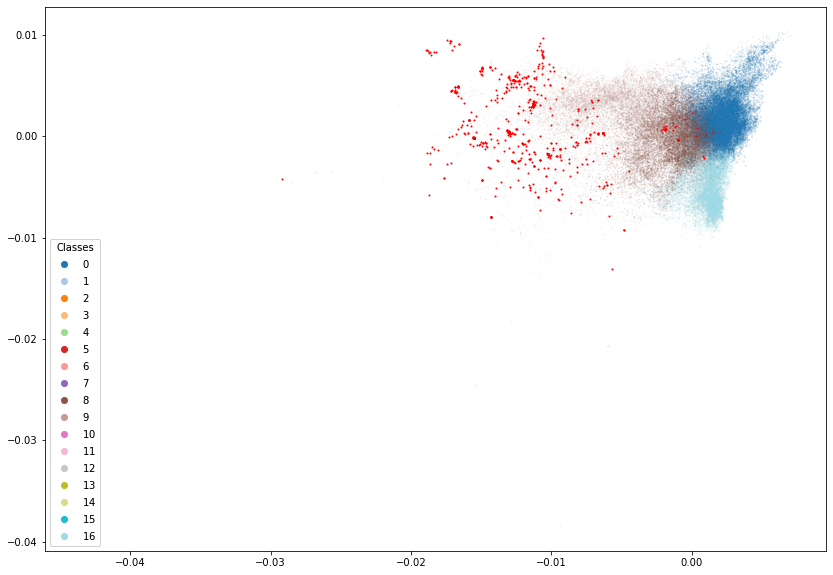

In [13]:
fig, ax = plt.subplots(1, figsize = (14, 10))
scatter = plt.scatter(pca_float.components_[0], pca_float.components_[1], s = .005, c=labels.clusters.values, cmap='tab20', label=labels.clusters.values)
scatter2 = plt.scatter(pca_float.components_[0][~labels.clusters.isin([0, 16, 8, 9, 12])], pca_float.components_[1][~labels.clusters.isin([0, 16, 8, 9, 12])], s = 1, c='r')
legend1 = ax.legend(*scatter.legend_elements('colors', 18),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)

In [14]:
dbscan = cuml.DBSCAN(eps=25, min_samples=1000)
dbscan.fit(data)

DBSCAN(eps=25, handle=<cuml.raft.common.handle.Handle object at 0x7faa282fa390>, min_samples=1000, verbose=4, max_mbytes_per_batch=0, output_type='cudf', calc_core_sample_indices=True)

In [15]:
dbscan.labels_.value_counts()

 0    81448
-1      927
dtype: int32

<AxesSubplot:>

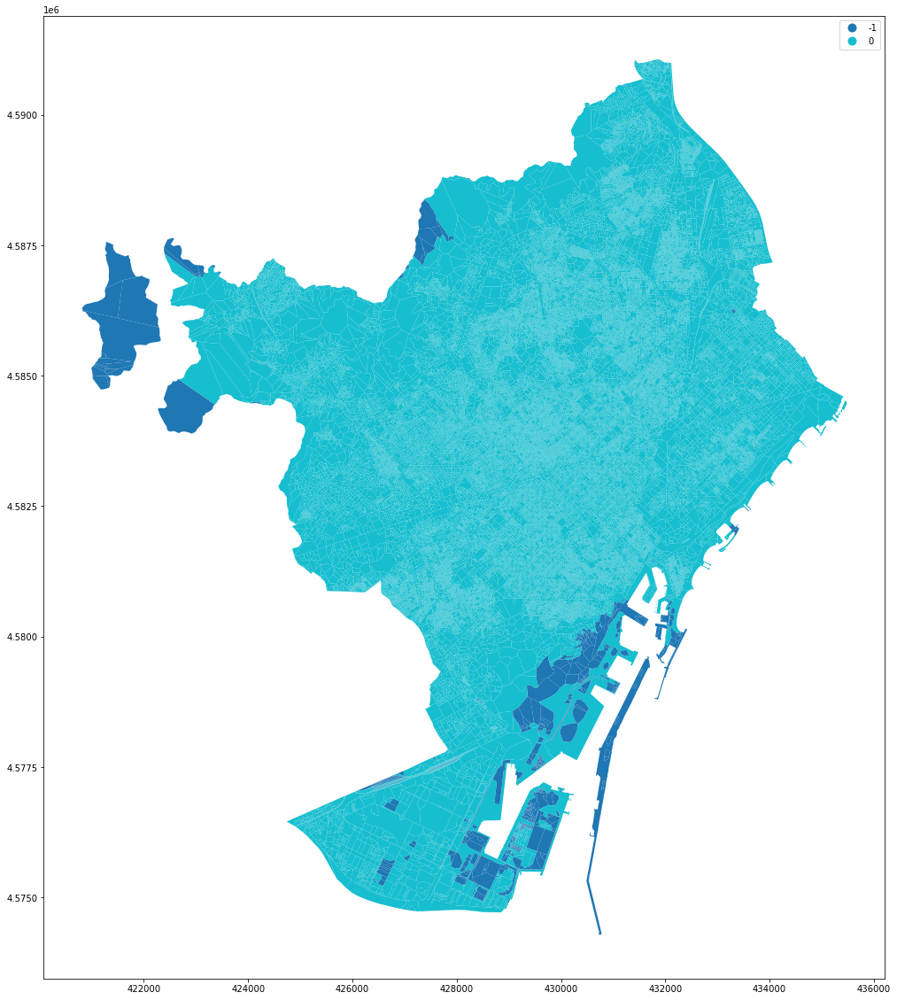

In [17]:
gdf.plot(dbscan.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)

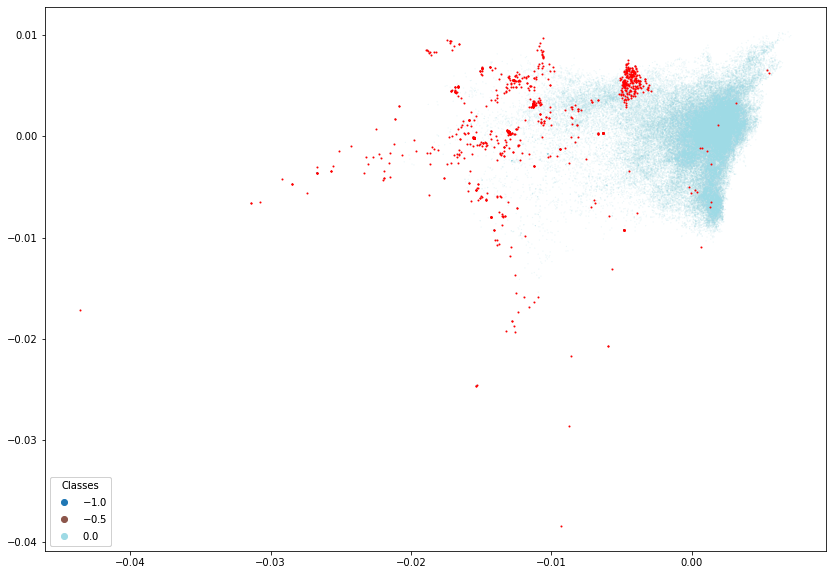

In [18]:
fig, ax = plt.subplots(1, figsize = (14, 10))

labs = dbscan.labels_.to_array()

scatter = plt.scatter(pca_float.components_[0], pca_float.components_[1], s = .005, c=labs, cmap='tab20')
scatter2 = plt.scatter(pca_float.components_[0][labs != 0], pca_float.components_[1][labs != 0], s = 1, c='r', cmap='tab20')
# scatter2 = plt.scatter(pca_float.components_[0][~labels.clusters.isin([0, 16, 8, 9, 12])], pca_float.components_[1][~labels.clusters.isin([0, 16, 8, 9, 12])], s = 1, c='r')
legend1 = ax.legend(*scatter.legend_elements('colors', 2),
                    loc="lower left", title="Classes")
ax.add_artist(legend1)

In [19]:
cg = Clustergram(range(1, 30), backend='cuML', n_init=10)
cg.fit(data[labs == 0])

PCA computed in 0.07715702056884766 seconds.
K=1 fitted in 1.3902249336242676 seconds.
K=2 fitted in 2.968261480331421 seconds.
K=3 fitted in 4.920335054397583 seconds.
K=4 fitted in 6.406586170196533 seconds.
K=5 fitted in 4.545974254608154 seconds.
K=6 fitted in 9.230101346969604 seconds.
K=7 fitted in 9.58447527885437 seconds.
K=8 fitted in 13.072758913040161 seconds.
K=9 fitted in 12.799537181854248 seconds.
K=10 fitted in 10.024179220199585 seconds.
K=11 fitted in 9.305215835571289 seconds.
K=12 fitted in 10.798791885375977 seconds.
K=13 fitted in 9.376322746276855 seconds.
K=14 fitted in 12.935173511505127 seconds.
K=15 fitted in 15.917510271072388 seconds.
K=16 fitted in 15.071285247802734 seconds.
K=17 fitted in 17.676604986190796 seconds.
K=18 fitted in 15.609446048736572 seconds.
K=19 fitted in 15.02450966835022 seconds.
K=20 fitted in 17.818890810012817 seconds.
K=21 fitted in 16.889872550964355 seconds.
K=22 fitted in 18.12534523010254 seconds.
K=23 fitted in 19.67480659484

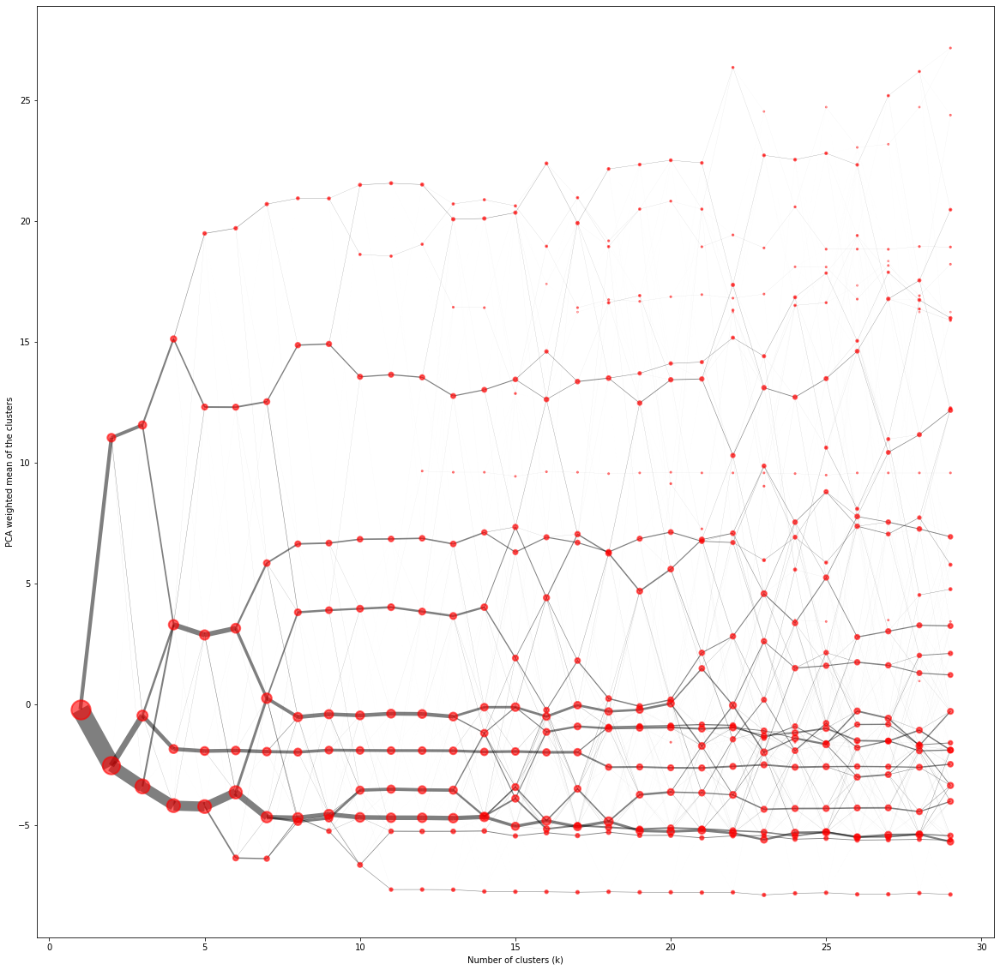

In [20]:
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})

In [21]:
km = cuml.KMeans(n_clusters=7, n_init=100).fit(data[labs == 0])

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

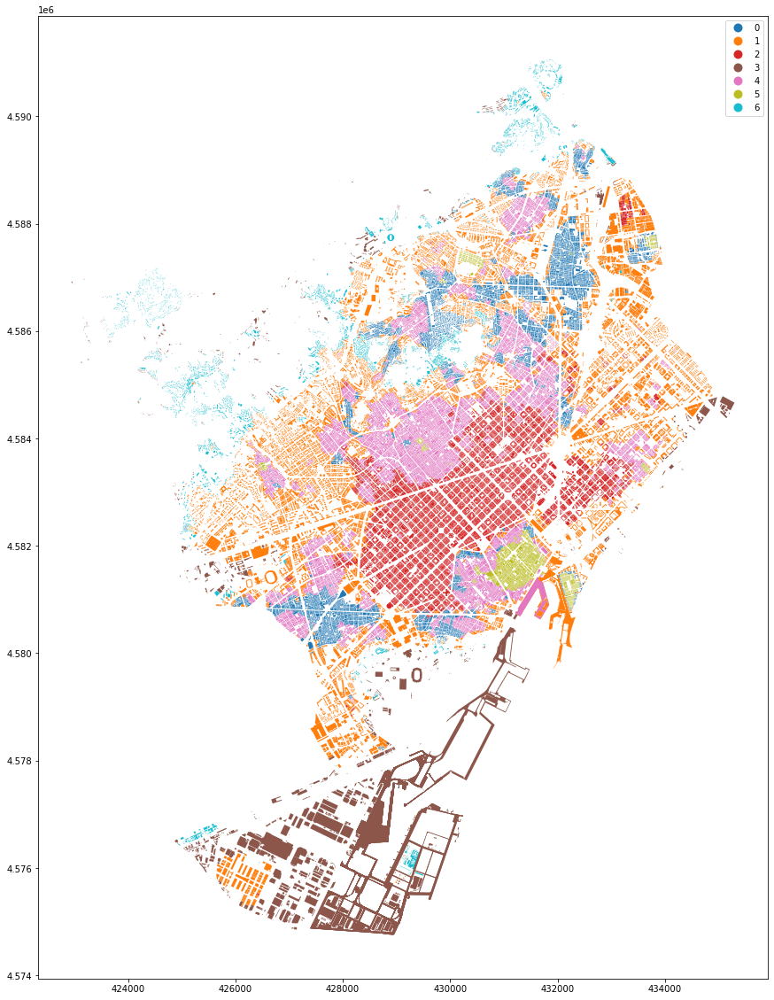

In [22]:
gdf[labs == 0].set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].set_geometry('buildings').plot(color='k', ax=ax)

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

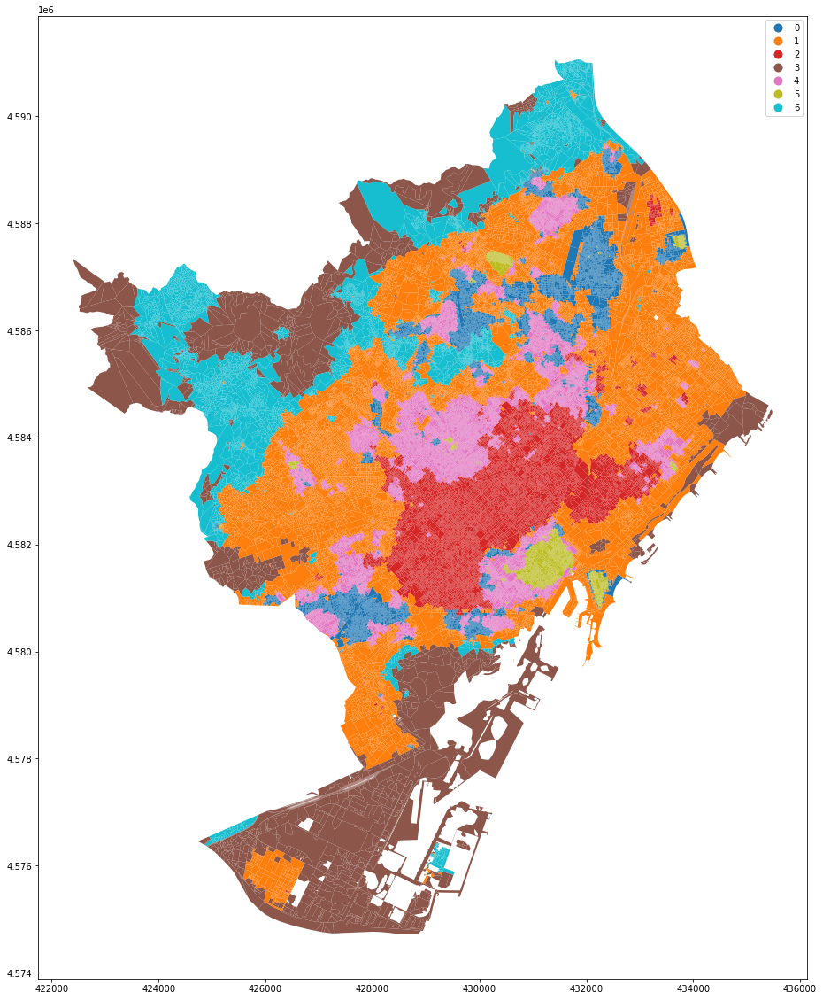

In [23]:
gdf[labs == 0].plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].plot(color='k', ax=ax)

In [24]:
km = cuml.KMeans(n_clusters=10, n_init=100).fit(data[labs == 0])

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

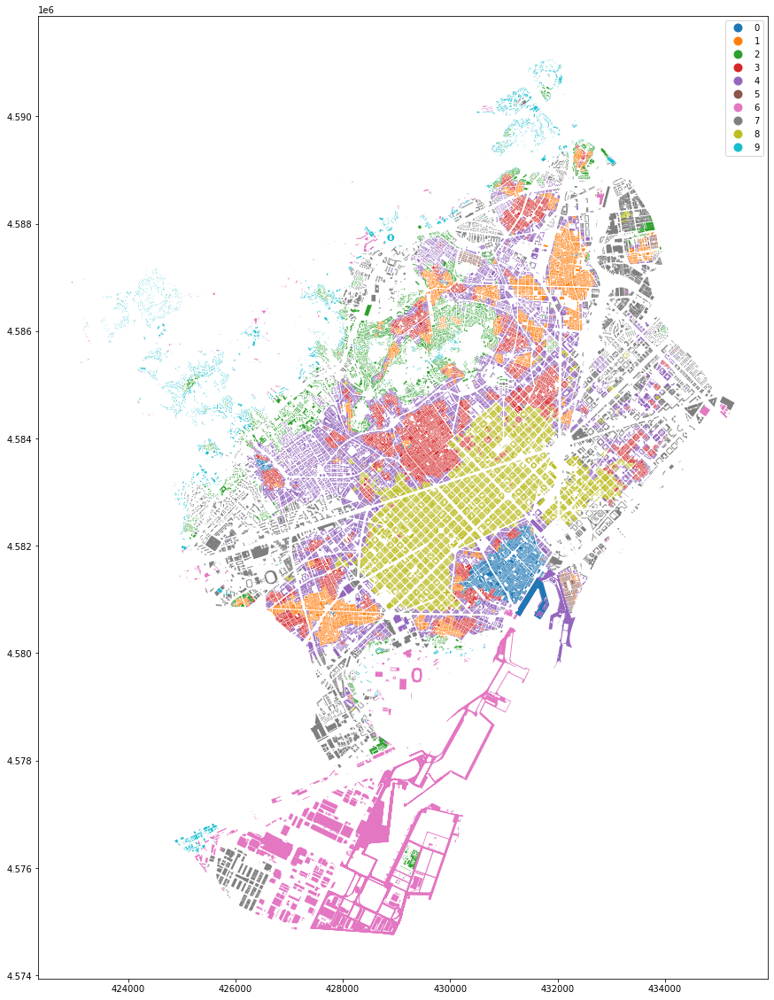

In [25]:
gdf[labs == 0].set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].set_geometry('buildings').plot(color='k', ax=ax)

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

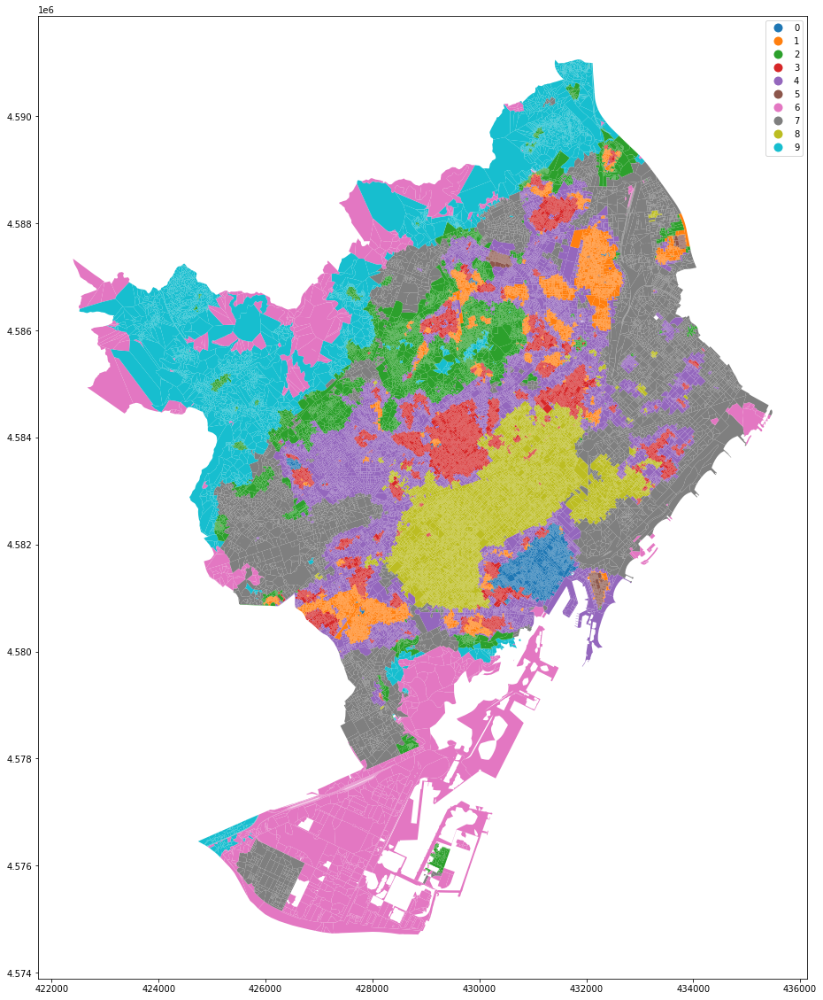

In [26]:
gdf[labs == 0].plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf[labs != 0].plot(color='k', ax=ax)

In [20]:
data = data.as_matrix()

In [35]:
som_shape = (4, 4)
som = MiniSom(som_shape[0], som_shape[1], data.shape[1], sigma=1.25, learning_rate=.1,
              neighborhood_function='gaussian', random_seed=10)
som.train_batch(data, 50000, verbose=True)

 [ 50000 / 50000 ] 100% - 0:00:00 left 
 quantization error: 11.160270955930306


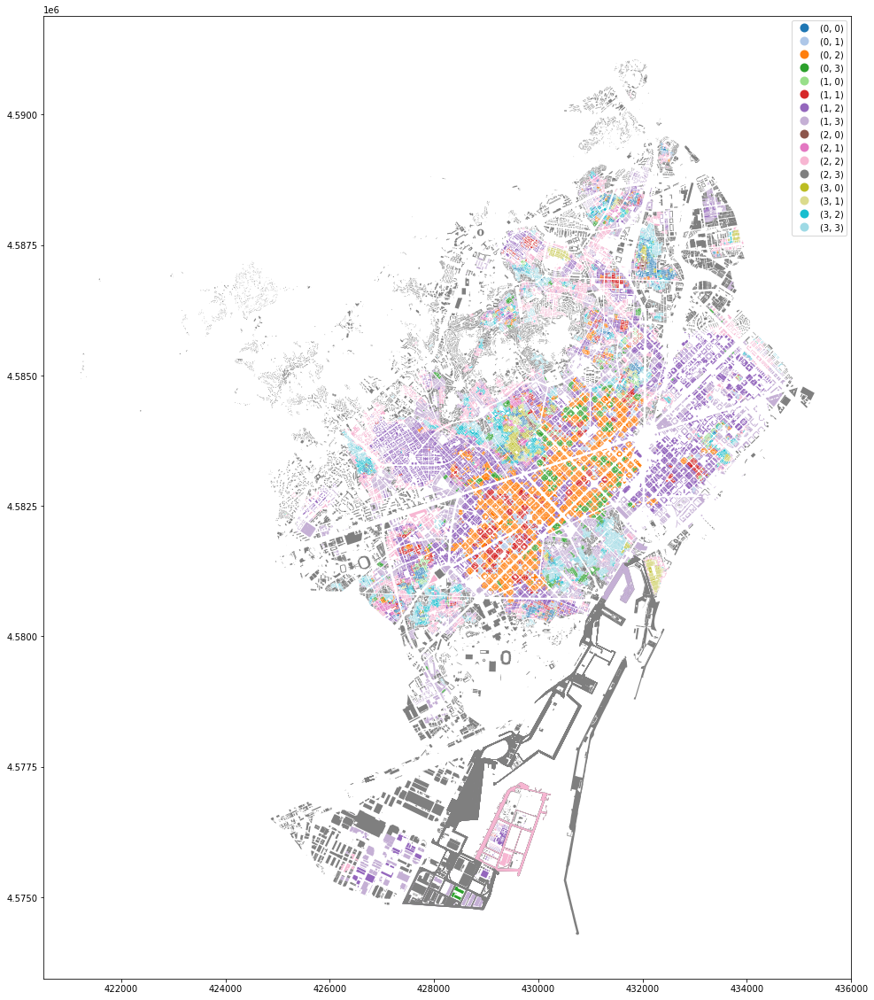

In [36]:
winner_coordinates = np.array([som.winner(x) for x in data])
hashes = np.apply_along_axis(lambda x: str(tuple(x)), 1, winner_coordinates)
ax = gdf.set_geometry('buildings').plot(hashes, legend=True, figsize=(20, 20), categorical=True, cmap='tab20')

### queen 10

In [8]:
df10 = pd.read_parquet("../../urbangrammar_samba/sp_sig_concept/barcelona/convolutions_q10.pq")
df10 = df10.fillna(0)
data = (df10 - df10.mean()) / df10.std()
data = data.fillna(0)

In [9]:
data.isna().any().any()

False

In [10]:
data = cudf.from_pandas(data)

In [11]:
data.nans_to_nulls().isna().any().any()

False

In [12]:
pdf = data.to_pandas()

PCA computed in 0.11246871948242188 seconds.
K=1 fitted in 1.4069030284881592 seconds.
K=2 fitted in 1.4172418117523193 seconds.
K=3 fitted in 1.8079965114593506 seconds.
K=4 fitted in 2.5279881954193115 seconds.
K=5 fitted in 3.496829032897949 seconds.
K=6 fitted in 3.671403646469116 seconds.
K=7 fitted in 3.4594223499298096 seconds.
K=8 fitted in 3.607029438018799 seconds.
K=9 fitted in 3.864515542984009 seconds.
K=10 fitted in 3.813978910446167 seconds.
K=11 fitted in 4.309239149093628 seconds.
K=12 fitted in 5.074766397476196 seconds.
K=13 fitted in 5.764745473861694 seconds.
K=14 fitted in 5.861517667770386 seconds.
K=15 fitted in 7.089661121368408 seconds.
K=16 fitted in 7.610518217086792 seconds.
K=17 fitted in 7.045271396636963 seconds.
K=18 fitted in 9.07113528251648 seconds.
K=19 fitted in 8.117372274398804 seconds.
K=20 fitted in 10.598515510559082 seconds.
K=21 fitted in 10.270423412322998 seconds.
K=22 fitted in 8.721359252929688 seconds.
K=23 fitted in 10.286149263381958 

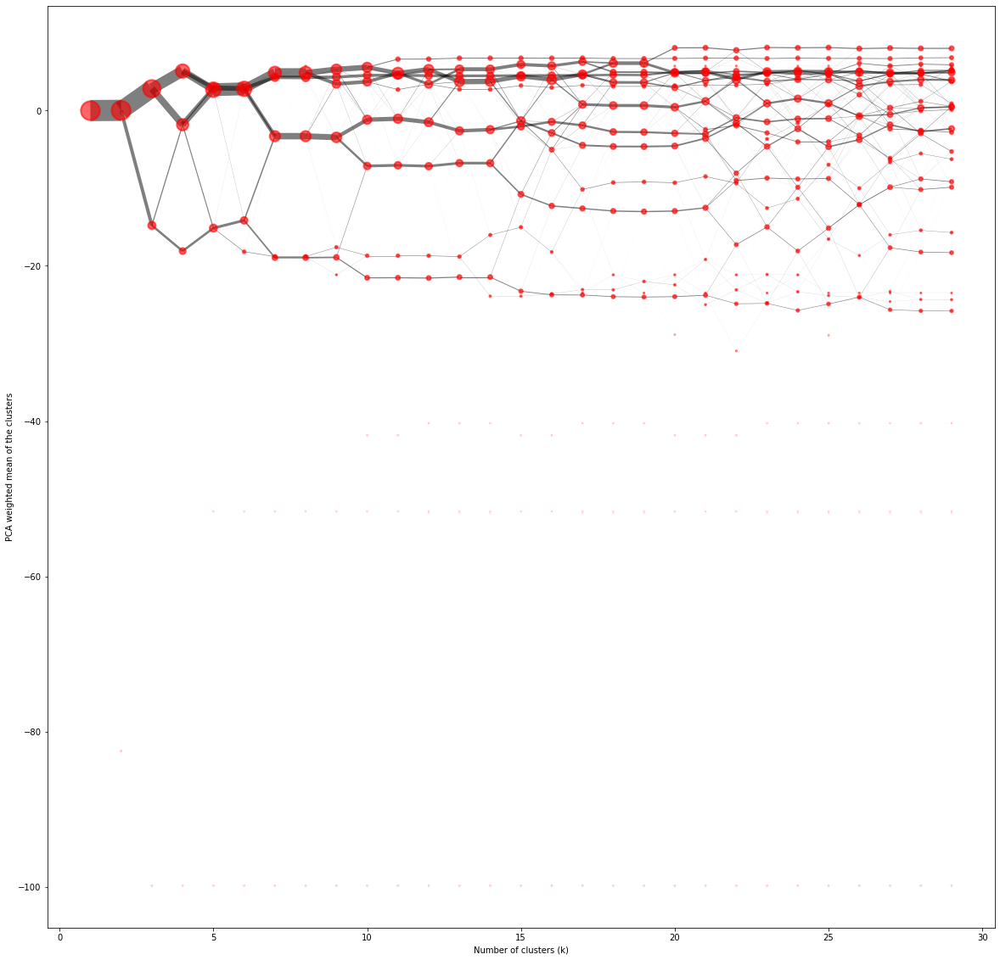

In [68]:
cg = Clustergram(range(1, 30), backend='cuML', n_init=10)
cg.fit(data)
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})

(-34.0, 10.0)

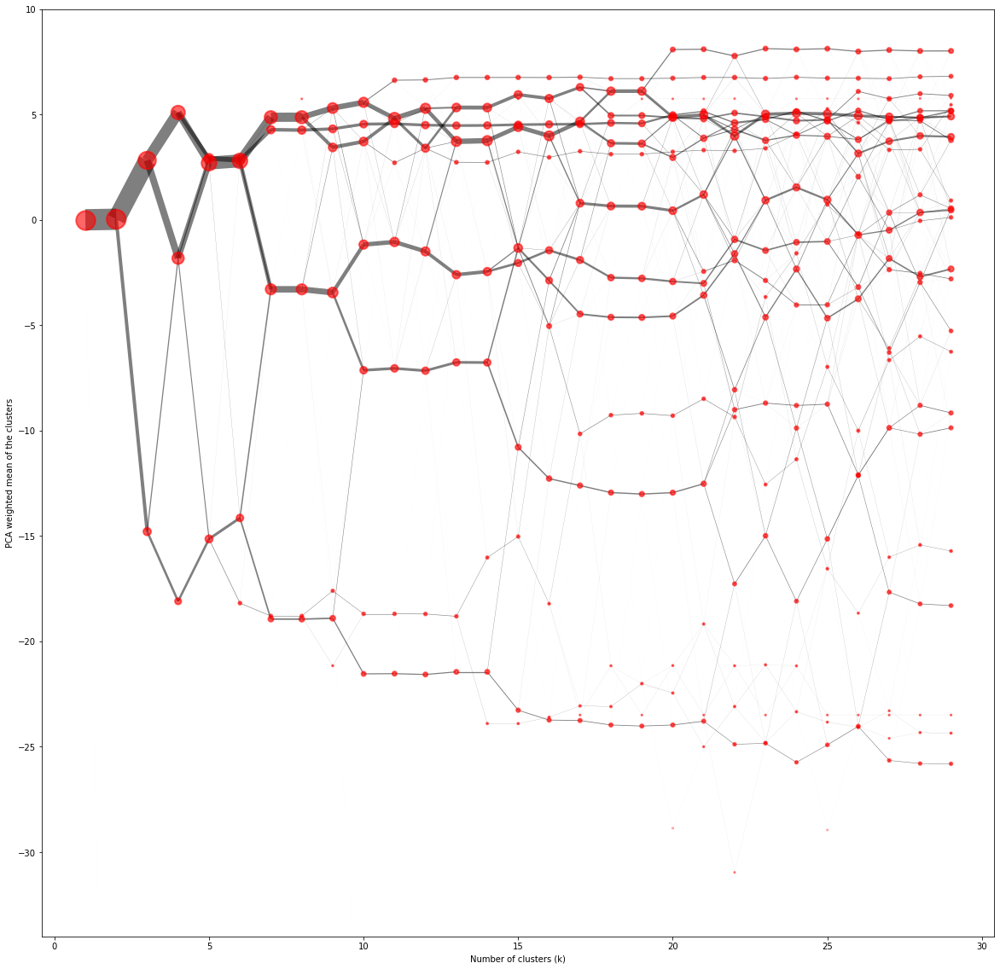

In [79]:
ax = cg.plot(figsize=(20, 20), linewidth=0.5, cluster_style={"edgecolor": "r", "alpha":.6}, size=1,
       line_style={"alpha":.5})
ax.set_ylim(-34, 10)

In [69]:
km = cuml.KMeans(n_clusters=10, n_init=100).fit(data)

<AxesSubplot:xlabel='Number of clusters (k)', ylabel='PCA weighted mean of the clusters'>

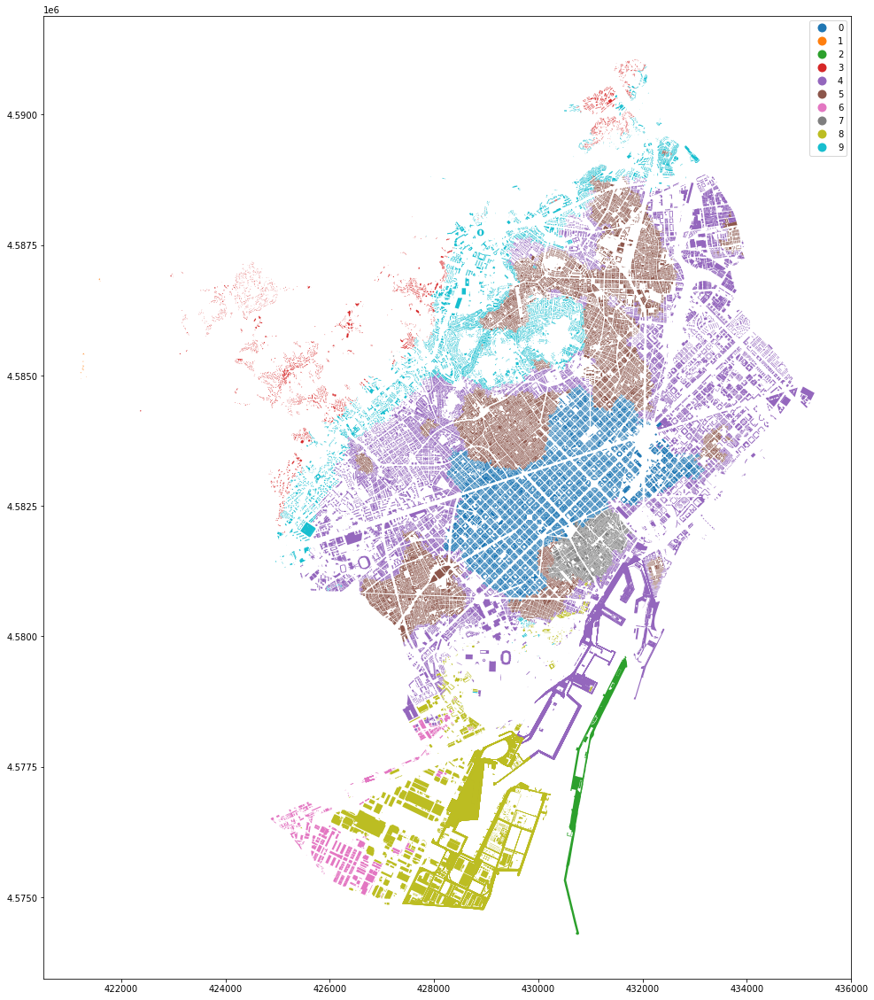

In [70]:
gdf.set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)
gdf.set_geometry('buildings').plot(color='k', ax=ax)

<AxesSubplot:>

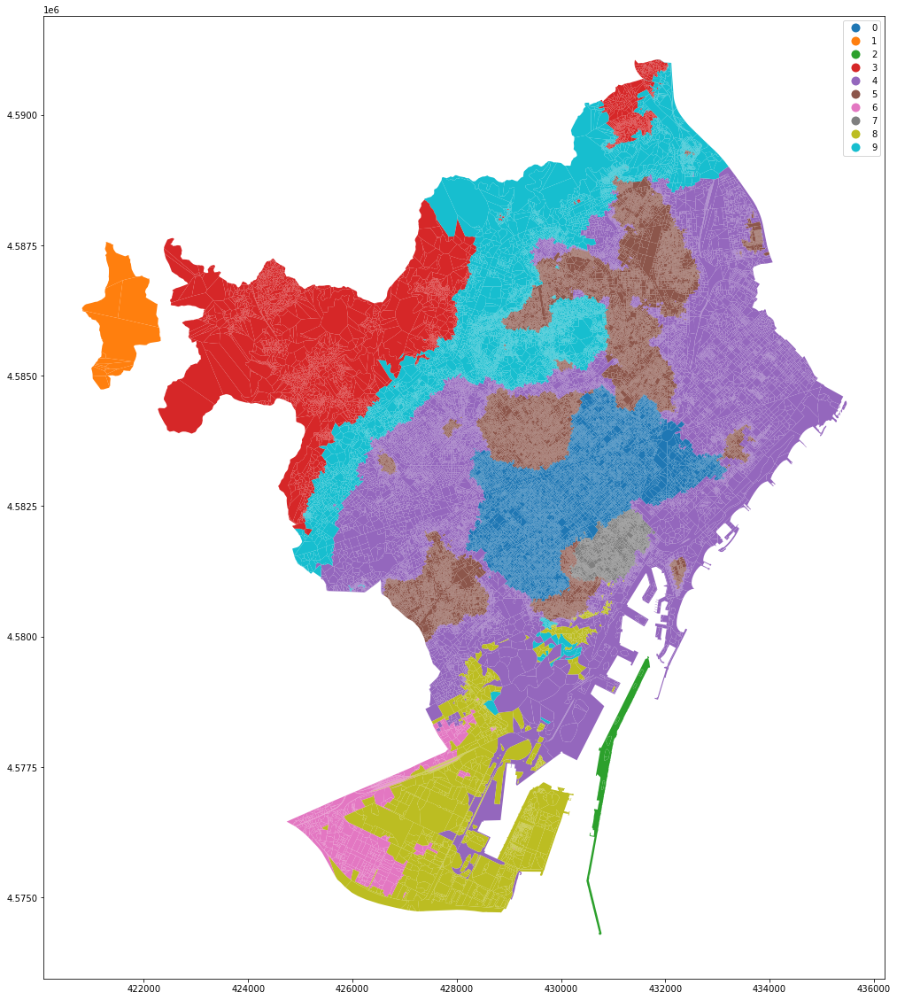

In [72]:
gdf.plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True)

In [84]:
km = cuml.KMeans(n_clusters=14, n_init=100).fit(data)

<AxesSubplot:>

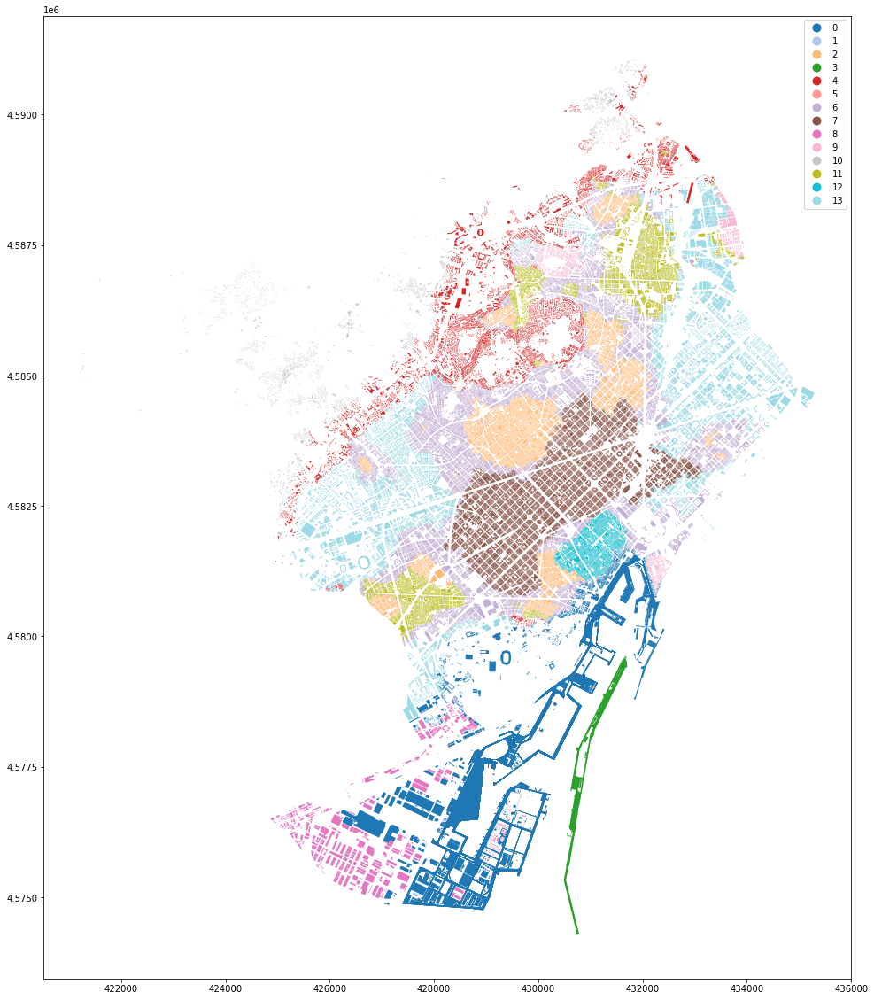

In [85]:
gdf.set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True, cmap='tab20')

<AxesSubplot:>

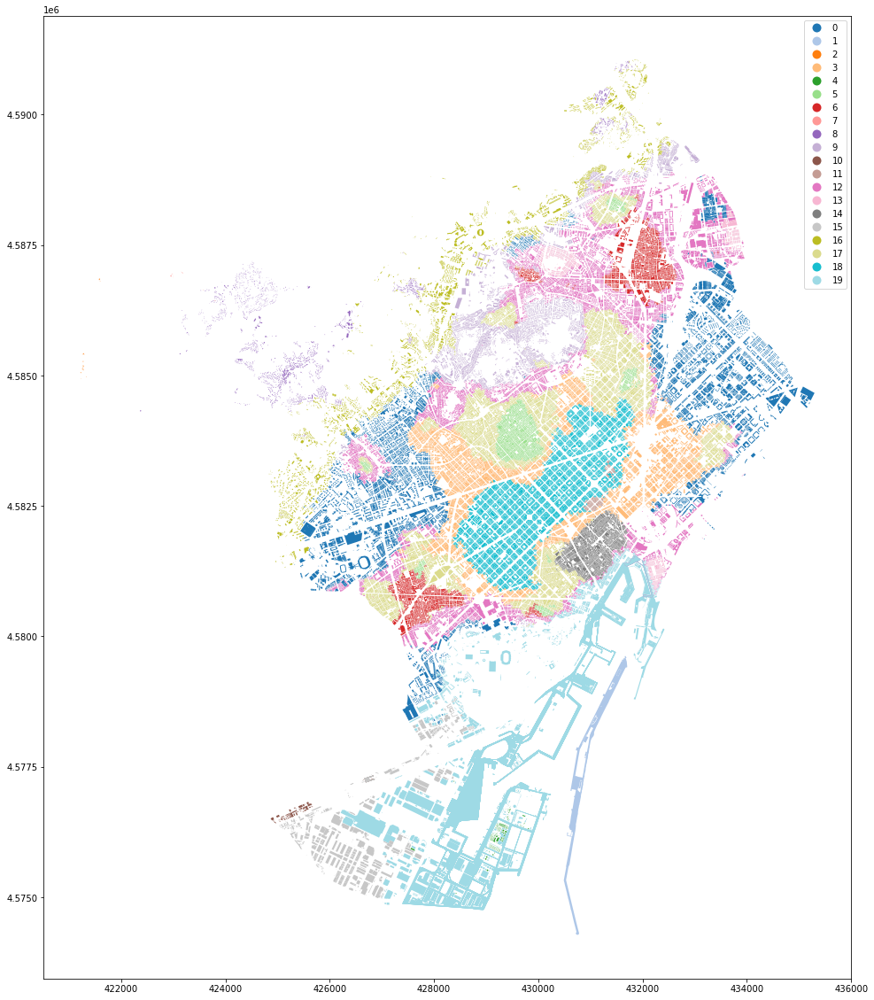

In [83]:
km = cuml.KMeans(n_clusters=20, n_init=100).fit(data)
gdf.set_geometry('buildings').plot(km.labels_.to_array(), legend=True, figsize=(20, 20), categorical=True, cmap='tab20')

In [29]:
som_shape = (4, 4)
som = MiniSom(som_shape[0], som_shape[1], data.shape[1], sigma=.25, learning_rate=.25,
              neighborhood_function='gaussian', random_seed=10)

In [30]:
som.train_batch(data.values, 50000, verbose=True)

 [ 50000 / 50000 ] 100% - 0:00:00 left 
 quantization error: 9.19291811775529


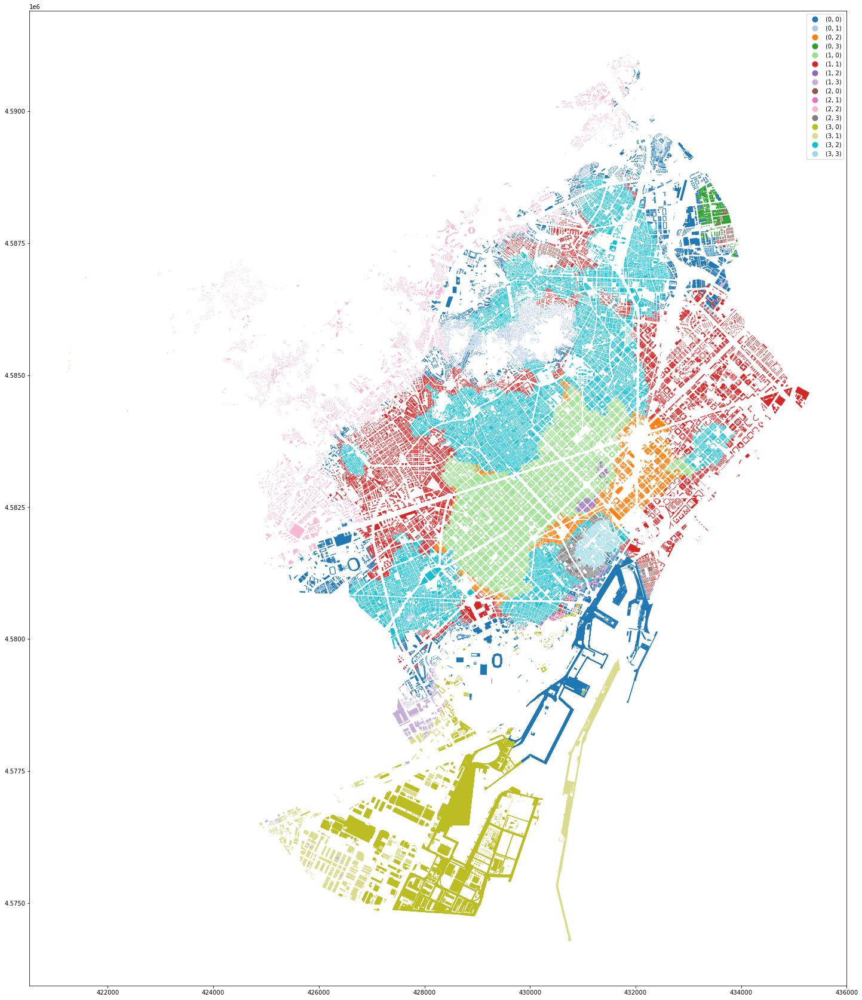

In [31]:
winner_coordinates = np.array([som.winner(x) for x in data.values])
hashes = np.apply_along_axis(lambda x: str(tuple(x)), 1, winner_coordinates)
ax = gdf.set_geometry('buildings').plot(hashes, legend=True, figsize=(30, 30), categorical=True, cmap='tab20')

In [14]:
n = 10

gmm = GaussianMixture(n_components=n, covariance_type="full", max_iter=200, n_init=5, verbose=1)
fitted = gmm.fit(pdf)

Initialization 0
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
Initialization converged: True
Initialization 1
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
Initialization converged: True
Initialization 2
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
Initialization converged: True
Initialization 3
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
  Iteration 70
Initialization converged: True
Initialization 4
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
Initialization converged: True


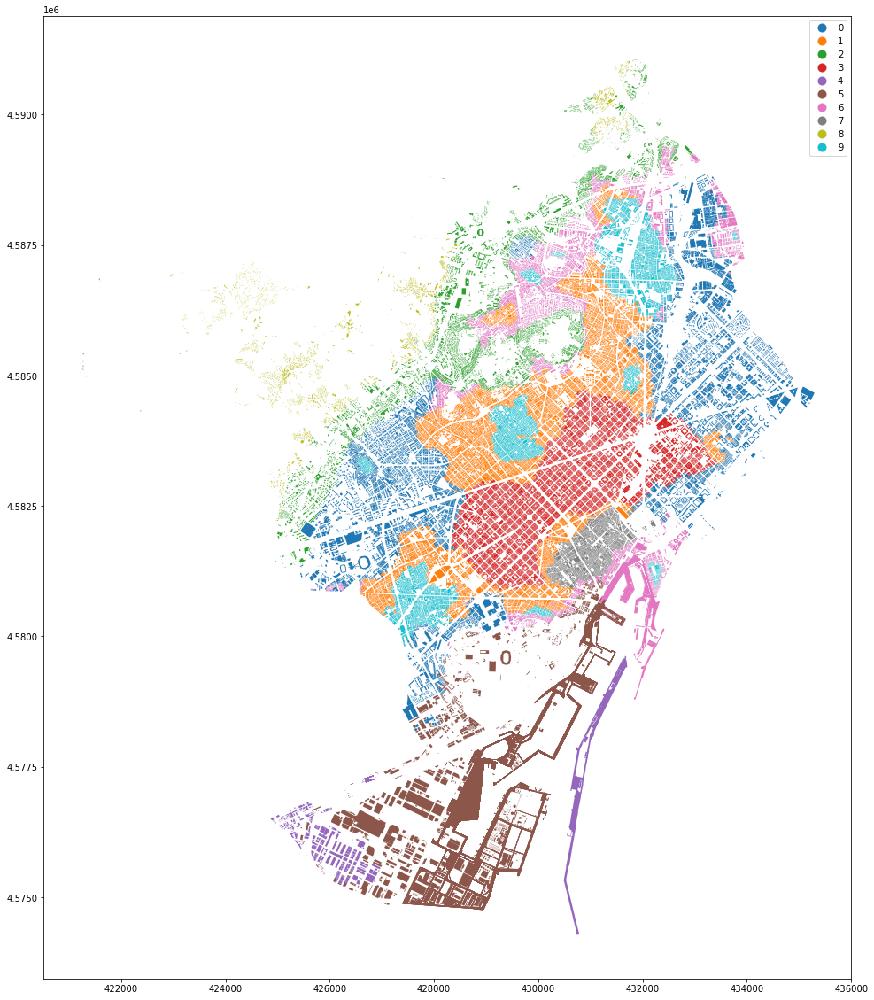

In [16]:
ax = gdf.set_geometry('buildings').plot(gmm.predict(data.as_matrix()), legend=True, figsize=(20, 20), categorical=True)

In [3]:
from pycave.bayes import GMM

In [9]:
data.shape

(82375, 177)

In [11]:
gmm = GMM(num_components=16, num_features=177, covariance='diag')

In [ ]:
history = gmm.fit(data)

In [89]:
%%time
gmm = GaussianMixture(n_components=15, covariance_type="full", max_iter=200, n_init=5, verbose=1)
fitted = gmm.fit(npdata)

Initialization 0
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
Initialization converged: True
Initialization 1
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
Initialization converged: True
Initialization 2
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
  Iteration 60
Initialization converged: True
Initialization 3
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
Initialization converged: True
Initialization 4
  Iteration 10
  Iteration 20
  Iteration 30
  Iteration 40
  Iteration 50
Initialization converged: True
CPU times: user 1h 48min 51s, sys: 2h 11min 30s, total: 4h 21s
Wall time: 16min 25s


In [130]:
pip install scikit-learn-extra

     |████████████████████████████████| 1.9 MB 6.6 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [131]:
from sklearn_extra.cluster import KMedoids

In [133]:
%%time
km = KMedoids(n_clusters=10, random_state=42).fit(npdata)

CPU times: user 2min 32s, sys: 2min 2s, total: 4min 35s
Wall time: 2min 6s


<AxesSubplot:>

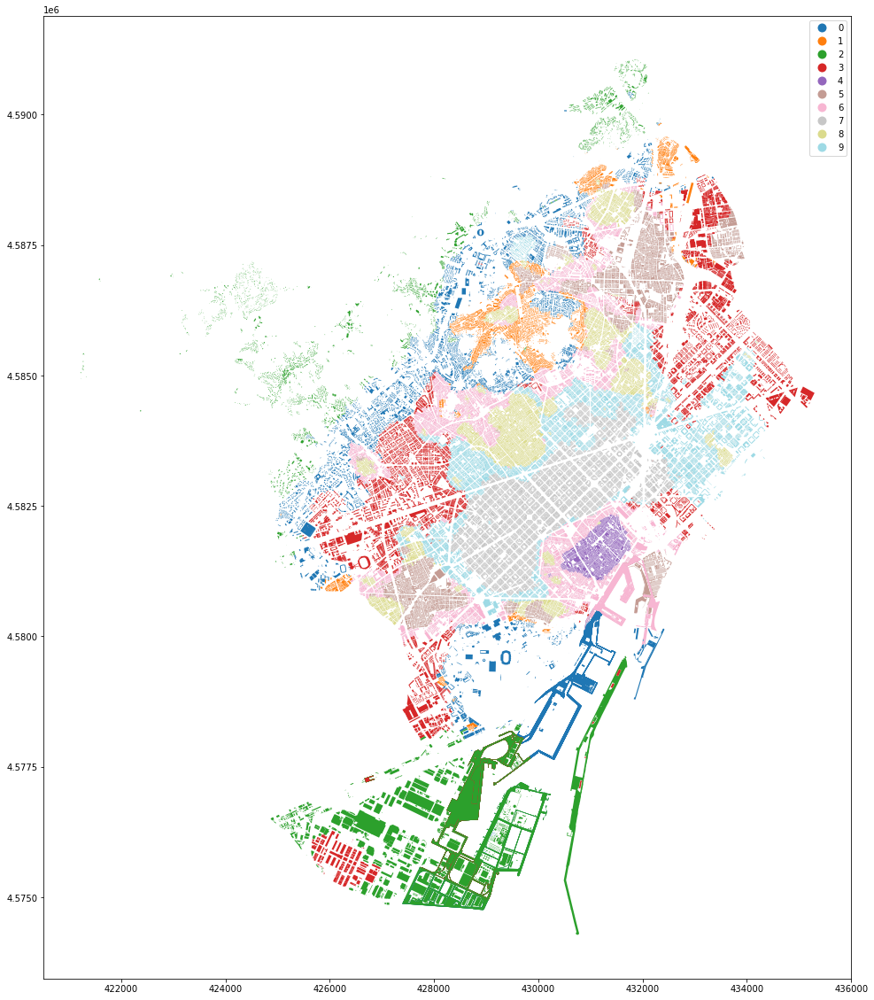

In [134]:
gdf.set_geometry('buildings').plot(km.labels_, legend=True, figsize=(20, 20), categorical=True, cmap='tab20')